In [1]:
# library(numbat)
library(ggplot2)
library(dplyr)
library(Matrix)
library(data.table)
library(stringr)
library(patchwork)
library(glue)
library(ggforce)
library(vcfR)
library(purrr)
library(magrittr)
library(parallel)
library(igraph)
library(ggrepel)
library(ape)
library(tidygraph)
library(ggtree)
library(ggpubr)
library(extraDistr)
library(IRdisplay)
library(ggridges)
library(logger)
options(repr.matrix.max.cols=30, repr.matrix.max.rows=20)
options(repr.vector.max.items = 50)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last



   *****       ***   vcfR   ***       *****
   This is vcfR 1.12.0 
     browseVignettes('vcfR') # Documentation
     citation('vcfR') # Citation
   *****       *****      *****       *****



Attaching package: ‘purrr’


The following object is masked from ‘package:data.table’:

    transpose



Attaching package: ‘magrittr’


The following object is masked from ‘package:purrr’:

    set_names



Attaching package: ‘igraph’


The following objects are masked from ‘package:purrr’:

    compose, simplify


The following objects are masked from ‘package:dplyr’:

    as_data_frame, groups, union


The following objects are masked from ‘package:stats’:

    decompose, spectru

In [3]:
con_TNBC = readRDS('~/paper_data/conos_objects/conos_TNBC.rds')

cell_annot = fread('~/paper_data/cell_annotations/cell_annot_MDA.tsv', sep = ',') %>% 
    mutate(annot = copykat.pred) %>% 
    split(.$sample)

count_mat = t(con_TNBC$samples[['TNBC4']]$misc$rawCounts)

In [5]:
df = list()

df[['topmed']] = fread(glue('~/paper_data/processed/TNBC4_N_allele_counts.tsv.gz'), sep = '\t')
df[['1000G']] = fread(glue('~/paper_data/processed/TNBC4_N_1000G_allele_counts.tsv.gz'), sep = '\t')

# Define haplotype ground truth

In [6]:
devtools::load_all('~/numbat')

ℹ Loading numbat

Registered S3 method overwritten by 'dendextend':
  method     from 
  rev.hclust vegan

Warning message:
“replacing previous import ‘Matrix::expand’ by ‘ggtree::expand’ when loading ‘numbat’”


In [1430]:
cells_normal = cell_annot[['TNBC4']] %>% filter(annot == 'N') %>% pull(cell)

ref_normal = aggregate_counts(
    count_mat = count_mat[,cells_normal],
    annot = cell_annot[['TNBC4']] %>% 
        filter(cell %in% cells_normal) %>%
        mutate(group = 'N')
)

cell_dict
   N 
1864 


In [1331]:
cells_tumor = cell_annot[['TNBC4']] %>% filter(annot == 'T') %>% pull(cell)

bulk_tumor = get_bulk(
    count_mat = count_mat[,cells_tumor],
    df = df[['topmed']] %>% filter(cell %in% cells_tumor),
    lambdas_ref = ref_hca,
    gtf = gtf_hg38,
    genetic_map = genetic_map_hg38,
    min_depth = 0
) %>%
analyze_bulk(t = 1e-5, diploid_chroms = c(14, 15), allele_only = TRUE, retest = T, theta_min = 0.49)

number of genes left: 9272

Retesting CNVs..

Finishing..



In [1459]:
R.utils::sourceDirectory('~/Numbat/R')

bulk_tumor_joint = get_bulk(
    count_mat = count_mat[,cells_tumor],
    df = df[['topmed']] %>% filter(cell %in% cells_tumor),
    lambdas_ref = ref_normal,
    gtf = gtf_hg38,
    genetic_map = genetic_map_hg38,
    min_depth = 0
) %>%
analyze_bulk(t = 1e-3)

number of genes left: 9848

Retesting CNVs..

Finishing..



In [1460]:
bulk_tumor_joint2 %>% dim
bulk_tumor_joint %>% dim

[1] 41582    77

[1] 41582    77

Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 4 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 4 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 7 unlabeled data po

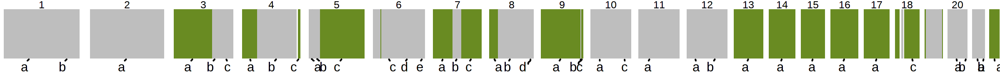

In [1332]:
options(repr.plot.width = 12, repr.plot.height = 1, repr.plot.res = 200)

bulk_tumor %>% 
get_segs_consensus() %>% 
mutate(
    cnv_state = ifelse(cnv_state == 'loh_1', 'loh', 'neu'),
    cnv_state_post = cnv_state
) %>%
plot_consensus()

Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 7 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 4 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 4 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 7 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 3 unlabeled data po

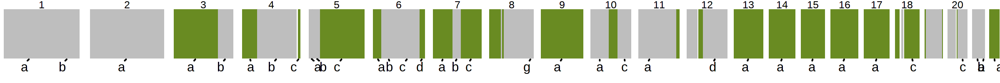

In [1325]:
options(repr.plot.width = 12, repr.plot.height = 1, repr.plot.res = 200)

bulk_tumor %>% 
get_segs_consensus() %>% 
mutate(
    cnv_state = ifelse(cnv_state == 'loh_1', 'loh', 'neu'),
    cnv_state_post = cnv_state
) %>%
plot_consensus()

In [1328]:
segs = bulk_tumor %>% get_segs_consensus()

In [1344]:
gaps_hg38_filtered = gaps_hg38 %>% filter(end - start > 1e6)

In [1386]:
acen = fread('~/ref/chromosome.band.hg38.txt') %>%
    rename(CHROM = `#chrom`) %>%
    filter(gieStain == 'acen') %>%
    mutate(acen_start = chromStart, acen_end = chromEnd) %>%
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    mutate(CHROM = factor(CHROM)) %>%
    filter(CHROM %in% 1:22)

Warning message:
“attributes are not identical across measure variables; they will be dropped”
Warning message:
“Using alpha for a discrete variable is not advised.”


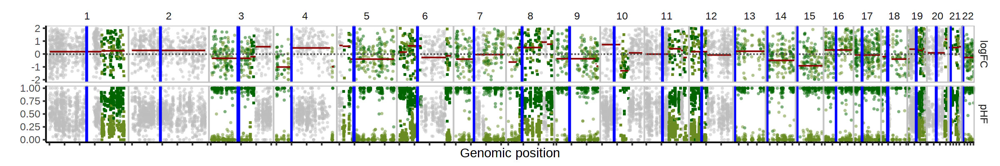

In [1387]:
options(repr.plot.width = 12, repr.plot.height = 2, repr.plot.res = 200)

bulk_tumor %>%
plot_psbulk(min_depth = 10, use_pos = TRUE) +
geom_vline(
    data = acen,
    aes(xintercept = acen_start),
    color = 'blue'
) +
geom_vline(
    data = acen,
    aes(xintercept = acen_end),
    color = 'blue'
)

In [1397]:
bulk_tumor = bulk_tumor %>% 
    left_join(
        acen %>% select(CHROM, acen_start, acen_end),
        by = 'CHROM'
    ) %>%
    mutate(arm = ifelse(POS <= acen_start, 'p', 'q'))

`summarise()` has grouped output by 'CHROM'. You can override using the `.groups` argument.


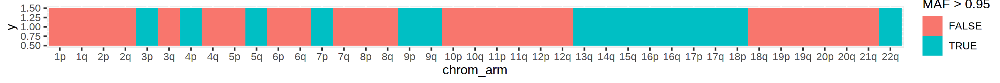

In [1424]:
options(repr.plot.width = 12, repr.plot.height = 1, repr.plot.res = 200)

D = bulk_tumor %>% 
    filter(!is.na(AD)) %>%
    group_by(CHROM, arm) %>%
    mutate(ppAD = ifelse(AR > 0.5, AD, DP-AD)) %>%
    summarise(
        pAD = sum(ppAD),
        DP = sum(DP),
        MAF = pAD/DP
    ) %>%
    mutate(chrom_arm = paste0(CHROM, arm)) %>%
    mutate(chrom_arm = factor(chrom_arm, unique(chrom_arm))) 

D %>%
    ggplot(
        aes(x = chrom_arm, y = 1, fill = MAF > 0.95)
    ) +
    geom_tile()

In [1466]:
bulk_tumor_joint = bulk_tumor_joint %>% 
    left_join(
        acen %>% select(CHROM, acen_start, acen_end),
        by = 'CHROM'
    ) %>%
    mutate(arm = ifelse(POS <= acen_start, 'p', 'q'))

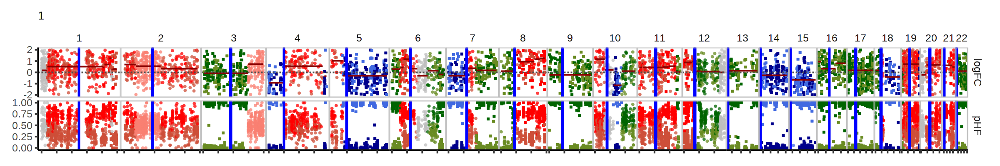

In [1489]:
options(repr.plot.width = 12, repr.plot.height = 2, repr.plot.res = 200)

bulk_tumor_joint %>%
plot_bulks(min_depth = 15, use_pos = TRUE) +
geom_vline(
    data = acen,
    aes(xintercept = acen_start),
    color = 'blue'
) +
geom_vline(
    data = acen,
    aes(xintercept = acen_end),
    color = 'blue'
)

Warning message:
“attributes are not identical across measure variables; they will be dropped”
Warning message:
“Using alpha for a discrete variable is not advised.”


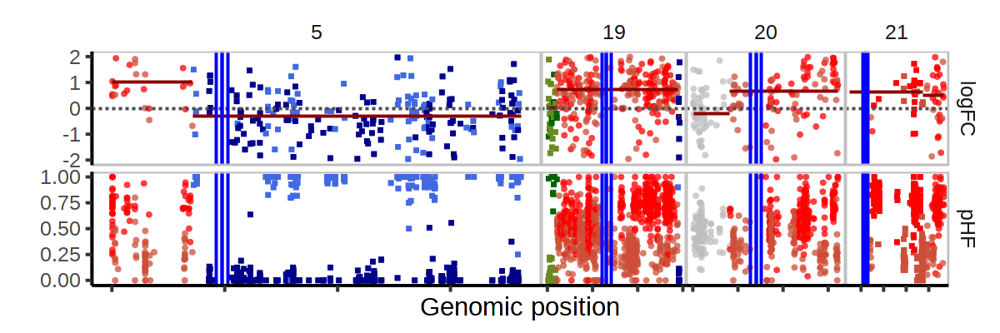

In [1498]:
options(repr.plot.width = 6, repr.plot.height = 2, repr.plot.res = 200)

bulk_tumor_joint %>%
filter(CHROM %in% c(5, 19, 20, 21)) %>%
plot_psbulk(min_depth = 8, use_pos = TRUE) +
geom_vline(
    data = acen %>% filter(CHROM %in% c(5, 19, 20, 21)),
    aes(xintercept = acen_start),
    color = 'blue'
) +
geom_vline(
    data = acen %>% filter(CHROM %in% c(5, 19, 20, 21)),
    aes(xintercept = acen_end),
    color = 'blue'
)

In [1493]:
dff = df[['topmed']] %>%
    left_join(
        acen %>% select(CHROM, acen_start, acen_end),
        by = 'CHROM'
    ) %>%
    mutate(arm = ifelse(POS <= acen_start, 'p', 'q'))

`summarise()` has grouped output by 'CHROM'. You can override using the `.groups` argument.
Warning message:
“Removed 1 rows containing missing values (geom_point).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”


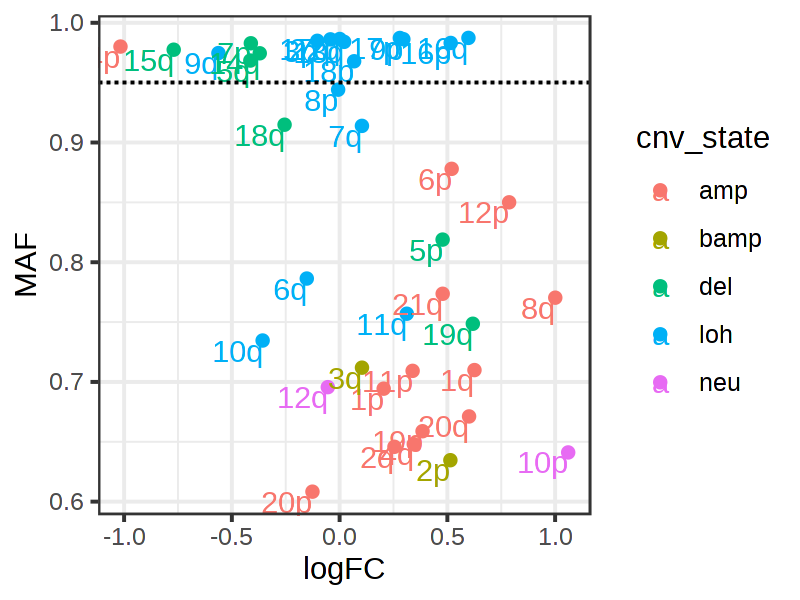

In [1488]:
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 200)

bulk_tumor_joint %>%
    group_by(CHROM, arm) %>%
    mutate(ppAD = ifelse(AR > 0.5, AD, DP-AD)) %>%
    summarise(
        pAD = sum(ppAD, na.rm = T),
        DP = sum(DP, na.rm = T),
        MAF = pAD/DP,
        Y_obs = sum(Y_obs, na.rm = T),
        logFC = mean(logFC, na.rm = T),
        phi_mle = mean(phi_mle, na.rm = T),
        cnv_state = last(unique(cnv_state_post, na.rm = T))
    ) %>%
    mutate(chrom_arm = paste0(CHROM, arm)) %>%
    mutate(chrom_arm = factor(chrom_arm, unique(chrom_arm))) %>%
    ggplot(
        aes(x = logFC, y = MAF, label = chrom_arm, color = cnv_state)
    ) +
    geom_point() +
    geom_text(hjust = 1, vjust = 1) +
    theme_bw() +
    geom_hline(yintercept = 0.95, linetype = 'dashed')

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.



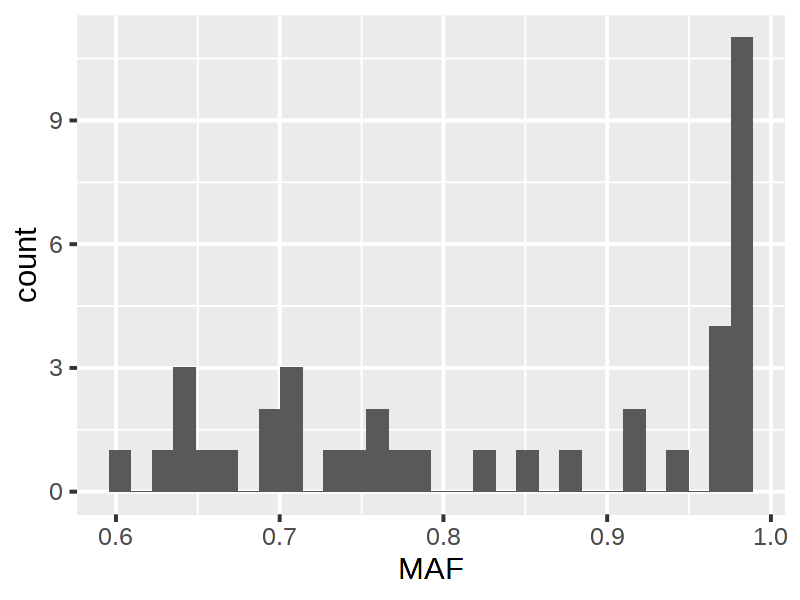

In [1417]:
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 200)

D %>%
ggplot(
    aes(x = MAF)
) +
geom_histogram() +
geom_vline()

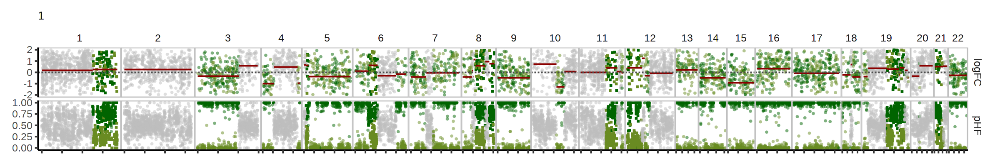

In [1315]:
options(repr.plot.width = 12, repr.plot.height = 2, repr.plot.res = 200)

bulk_tumor %>%
plot_bulks(min_depth = 10)

Warning message:
“attributes are not identical across measure variables; they will be dropped”
Warning message:
“Using alpha for a discrete variable is not advised.”


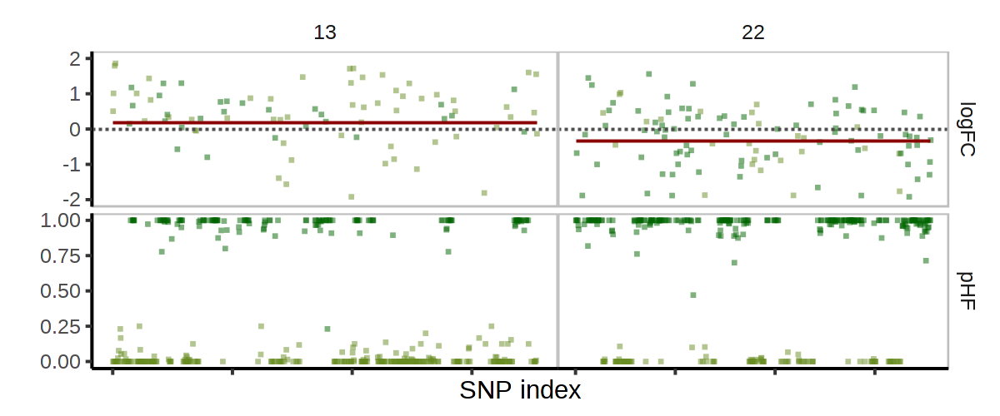

In [1247]:
options(repr.plot.width = 6, repr.plot.height = 2.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

bulk_tumor %>% filter(CHROM %in% c(13, 22)) %>%
plot_psbulk()

Warning message:
“attributes are not identical across measure variables; they will be dropped”
Warning message:
“Using alpha for a discrete variable is not advised.”


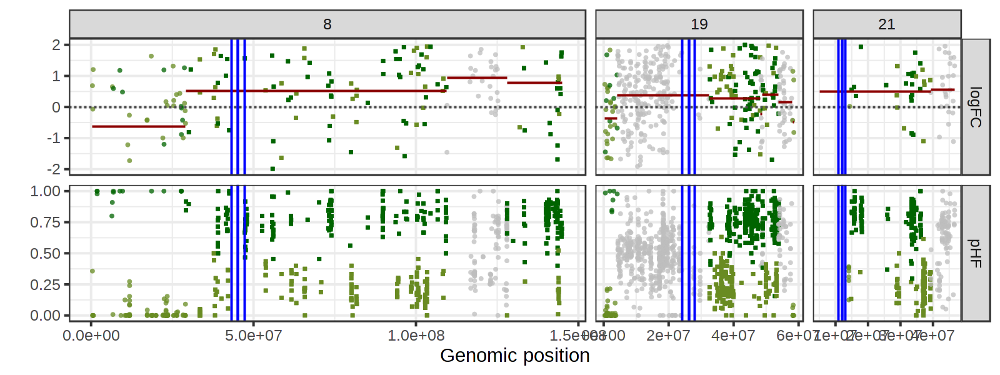

In [1442]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
chroms_amp = c(8,19,21)
bulk_tumor %>%
filter(CHROM %in% chroms_amp) %>%
plot_psbulk(min_depth = 10, theta_roll = F, use_pos = T) +
geom_vline(
    data = acen %>% filter(CHROM %in% chroms_amp),
    aes(xintercept = acen_start),
    color = 'blue'
) +
geom_vline(
    data = acen %>% filter(CHROM %in% chroms_amp),
    aes(xintercept = acen_end),
    color = 'blue'
) +
theme_bw()

In [1449]:
nb = Numbat$new('~/ATC2_test',i=2)

In [ ]:
nb$bulk_subtrees %>% filter(sample == 4)

In [1212]:
segs_numbat = fread('~/paper_data/numbat_out/TNBC4_new/segs_consensus_2.tsv')

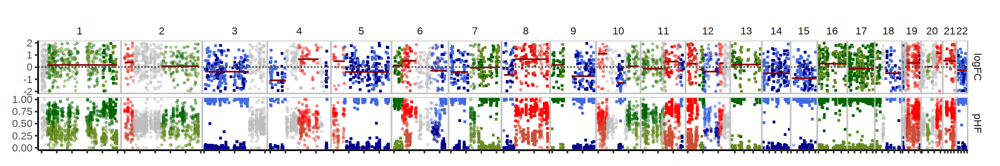

In [1222]:
options(repr.plot.width = 12, repr.plot.height = 2, repr.plot.res = 200)

bulk_tumor_joint %>%
annot_consensus(segs_numbat) %>%
plot_bulks(min_depth = 15, use_pos = TRUE)

In [29]:
segs_consensus = get_segs_consensus(bulk_tumor)

chroms = c(3, 5, 9, 13:17, 22)

haplo_truth = bulk_tumor %>%
    filter(CHROM %in% chroms & cnv_state == 'loh_2') %>%
    filter(!is.na(AD)) %>%
    mutate(haplo_truth = ifelse(AR < 0.5, 'minor', 'major')) %>%
    select(CHROM, snp_id, haplo_truth, AD, DP, AR)

# Phasing statistics

In [17]:
# assign contiguous correctly phased segments
assign_block = function(v) {c(0, cumsum(v[1:length(v)-1] != v[2:length(v)])) + 1}

bulk_phased = bulk_tumor %>% 
    mutate(BAF = AD/DP) %>%
    filter(CHROM %in% chroms & cnv_state == 'loh_2') %>%
    filter(!is.na(pAD)) %>%
    filter(!is.na(gene)) %>%
    rowwise() %>%
    mutate(p_binom = binom.test(x = AD, n = DP, p = 0.5)$p.value) %>%
    ungroup() %>%
    mutate(GT_truth = case_when(
        p_binom > 0.05 ~ 'unknown',
        BAF < 0.5 ~ '0|1',
        BAF >= 0.5 ~ '1|0'
    )) %>%
    filter(GT_truth != 'unknown') %>%
    group_by(CHROM) %>%
    mutate(
        config = GT_truth == GT,
        switch = c(0, config[2:length(config)] != config[1:(length(config)-1)]),
        phase_block = assign_block(config),
        phase_block = paste0(CHROM, '_', phase_block),
        p_s = switch_prob_cm(inter_snp_cm)
    ) %>%
    ungroup() 

In [69]:
D = bulk_phased %>% 
    group_by(phase_block, CHROM) %>%
    summarise(
        n_snps = n(),
        length = max(POS) - min(POS),
        n_genes = length(unique(gene)),
        .groups = 'drop'
    ) %>%
    ungroup()

cat('Number of consecutive genes:')
D %>% pull(n_genes) %>% summary
cat('Number of consecutive snps:')
D %>% pull(n_snps) %>% summary

Number of consecutive genes:

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  1.000   1.000   2.000   3.618   5.000  28.000 

Number of consecutive snps:

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   1.00    2.00    7.00   11.64   15.00   83.00 

In [1208]:
cat('Within gene phasing accuracy:')
bulk_phased %>%
group_by(CHROM, gene) %>%
filter(n() > 1) %>%
mutate(
    switch = c(NA, config[2:length(config)] != config[1:(length(config)-1)]),
    inter_snp_cm = c(NA, cM[2:length(cM)] - cM[1:(length(cM)-1)])
) %>%
ungroup() %>%
summarise(
    accuracy = 1-mean(na.omit(switch)),
    dist = mean(na.omit(inter_snp_cm))
) %>%
signif(3)

cat('Between gene phasing accuracy:')
bulk_phased %>%
group_by(CHROM, gene) %>%
filter(row_number() == 1 | row_number() == n()) %>%
group_by(CHROM) %>%
mutate(
    switch = c(NA, config[2:length(config)] != config[1:(length(config)-1)]),
    inter_snp_cm = c(NA, cM[2:length(cM)] - cM[1:(length(cM)-1)])
) %>%
group_by(CHROM, gene) %>%
filter(row_number() == 1) %>%
ungroup() %>%
summarise(
    accuracy = 1-mean(na.omit(switch)),
    dist = mean(na.omit(inter_snp_cm))
) %>%
signif(3)

Within gene phasing accuracy:

accuracy,dist
<dbl>,<dbl>
0.968,0.0127


Between gene phasing accuracy:

accuracy,dist
<dbl>,<dbl>
0.782,0.85


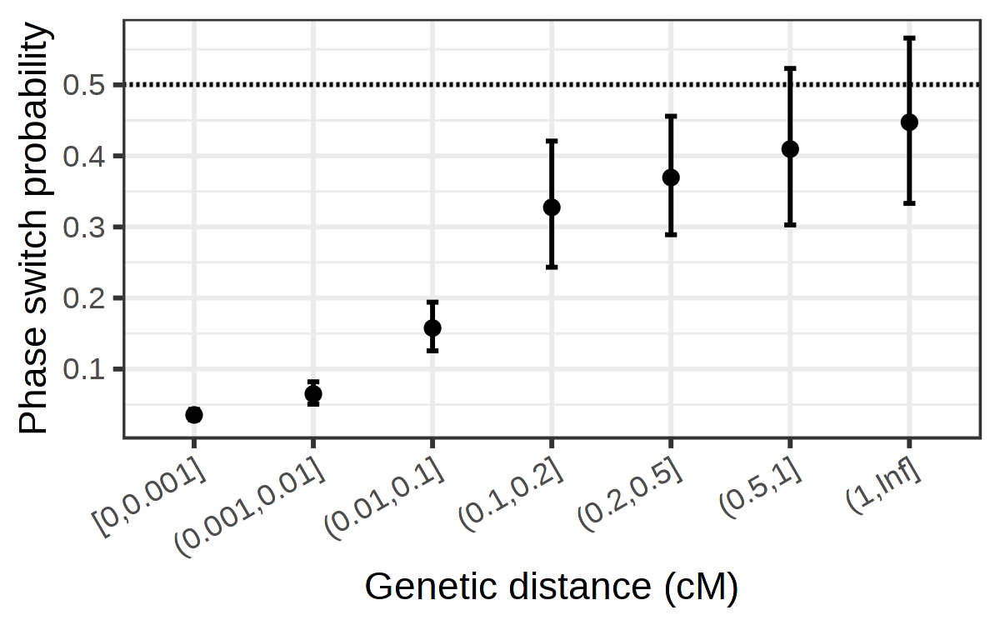

In [952]:
options(repr.plot.width = 4, repr.plot.height = 2.5, repr.plot.res = 300)

D = bulk_phased %>%
    filter(!is.na(inter_snp_cm)) %>%
    mutate(
        distance_bin = cut(
            inter_snp_cm,
            breaks = c(0, 1e-3, 1e-2, 0.1, 0.2, 0.5, 1, Inf),
            include.lowest = TRUE),
        p_s = switch_prob_cm(inter_snp_cm, lambda = 1)
    )

ggplot(
    D %>% group_by(distance_bin) %>%
    summarise(
        p_s = mean(switch),
        low = binom.test(x = sum(switch), n = n(), p = 0.5)$conf.int[1],
        high = binom.test(x = sum(switch), n = n(), p = 0.5)$conf.int[2],
    ),
    aes(x = distance_bin, y = p_s)
) +
geom_errorbar(aes(ymin = low, ymax = high), width = 0.1) +
geom_point() +
geom_hline(yintercept = 0.5, linetype = 'dashed') +
theme_bw() +
guides(color = guide_legend(title = '')) +
scale_color_manual(values = c('gray50', 'blue')) +
theme(axis.text.x = element_text(angle = 30, hjust = 1)) +
xlab('Genetic distance (cM)') +
ylab('Phase switch probability')
# ylim(0,0.5)

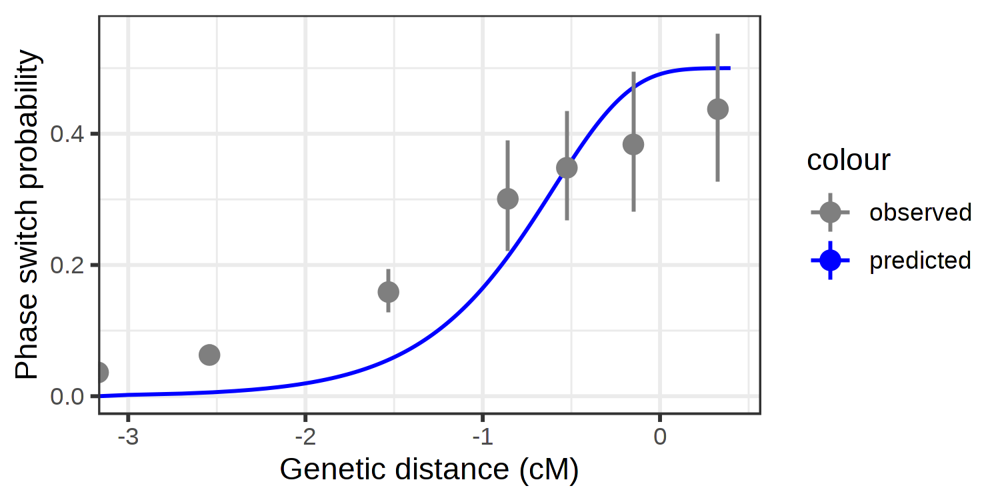

In [68]:
options(repr.plot.width = 5, repr.plot.height = 2.5, repr.plot.res = 300)

ggplot(
    data.frame(
        x = seq(0,2.5,0.001)
    ) %>%
    mutate(
        p_s = switch_prob_cm(x, lambda = 2)
    )
) +
geom_line(
    aes(x = log10(x), y = p_s, color = 'predicted')
) +
geom_pointrange(
    data = D %>% group_by(distance_bin) %>%
    summarise(
        p_s = mean(switch),
        inter_snp_cm = mean(log10(inter_snp_cm)),
        low = binom.test(x = sum(switch), n = n(), p = 0.5)$conf.int[1],
        high = binom.test(x = sum(switch), n = n(), p = 0.5)$conf.int[2],
    ),
    aes(x = inter_snp_cm, y = p_s, ymin = low, ymax = high, color = 'observed'),
) +
theme_bw() +
scale_color_manual(values = c('gray50', 'blue')) +
xlab('Genetic distance (cM)') +
ylab('Phase switch probability')

# ASE

In [22]:
cells_normal = cell_annot[['TNBC4']] %>% filter(annot == 'N') %>% pull(cell)

bulk_normal = get_bulk(
    count_mat = count_mat[,cells_normal],
    df = df[['topmed']] %>% filter(cell %in% cells_normal),
    lambdas_ref = ref_hca,
    gtf_transcript = numbat::gtf_hg38,
    genetic_map = genetic_map_hg38,
    min_depth = 0
) %>%
analyze_bulk()

Fitted reference proportions:

NK:0.0011,Fibroblast:0.021,Macrophage:0.019,CD4+T:0.37,CD8+T:0.15,Endothelial:0.017,Myeloid:0.0016,Monocyte:0.013,Dendritic:0.28,Plasma:0.097,B:0.017,Epithelial:0.0054

number of genes left: 10265

Retesting CNVs..

Finishing..



Warning message:
“attributes are not identical across measure variables; they will be dropped”
Warning message:
“Using alpha for a discrete variable is not advised.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


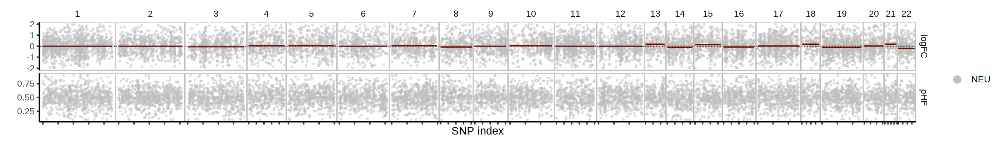

In [23]:
options(repr.plot.width = 14, repr.plot.height = 2, repr.plot.res = 200)

bulk_normal %>% plot_psbulk(min_depth = 10)

In [1171]:
cells_normal = cell_annot[['TNBC4']] %>% filter(annot == 'N') %>% pull(cell)

bulk_normal_gamma = mclapply(
    mc.cores = 10,
    c(25, 50, 100, 200, 400),
    function(n) {
        
        lapply(
            1:10,
            function(seed) {
                
                set.seed(seed)
                
                cell_sample = sample(cells_normal, n)

                get_allele_bulk(
                    df_allele = df[['topmed']] %>% filter(cell %in% cell_sample),
                    genetic_map = genetic_map_hg38,
                    min_depth = 0
                ) %>%
                mutate(n_cells = n, seed = seed)
                
            }
        ) %>% 
        bind_rows()
    }
) %>%
bind_rows()

In [1172]:
bulk_normal_phased = bulk_normal_gamma %>% 
    inner_join(
        bulk_phased %>% select(snp_id, GT_truth),
        by = 'snp_id'
    ) %>%
    filter(!is.na(gene)) %>%
    mutate(
        MD = ifelse(GT_truth == '0|1', AD, DP - AD),
        PD = DP - MD,
        gene_index = as.integer(factor(gene, unique(gene)))
    )

In [1173]:
options(repr.plot.width = 6, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

D = mclapply(
    mc.cores = 1,
    bulk_normal_phased %>% split(list(.$n_cells, .$seed)),
    function(bulk) {
        lapply(
            0:5,
            function(set_size) {
                                
                if (set_size > 0) {
                    max_index = max(bulk$gene_index)
                    gene_map = setNames(as.integer(cut(1:max_index, seq(0, to = max_index+1, by = set_size))), 1:max_index)
                    
                    bulk %>%
                        mutate(gene_set = gene_map[gene_index]) %>%
                        group_by(gene_set, n_cells, seed) %>%
                        summarise(
                            MD = sum(MD),
                            PD = sum(PD),
                            DP = sum(DP),
                            HF = MD/DP,
                            .groups = 'drop'
                        ) %>%
                        mutate(set_size = set_size)
                } else {
                    bulk %>%
                        select(gene_set = snp_index, n_cells, seed, MD, PD, DP) %>%
                        mutate(HF = MD/DP) %>%
                        mutate(set_size = set_size)
                }
            }
        )  %>%
        bind_rows()
    }
) %>% bind_rows()

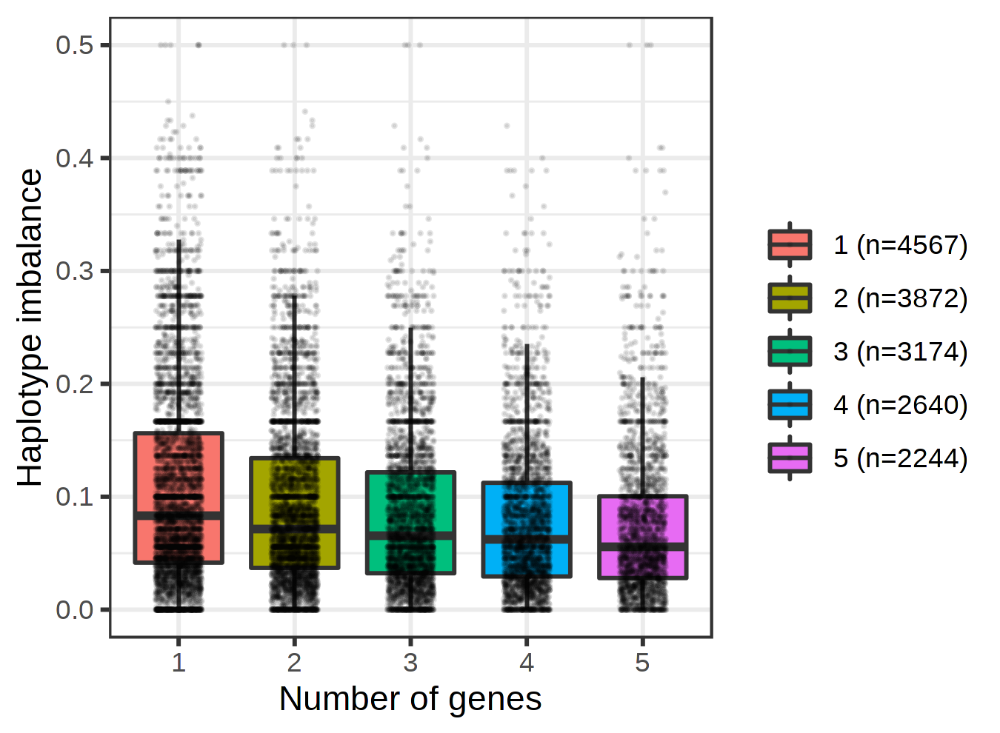

In [1204]:
options(repr.plot.width = 4.5, repr.plot.height = 3.3, repr.plot.res = 300)

D %>% 
filter(set_size > 0 & n_cells == 400 & set_size <= 5) %>%
filter(DP > 8) %>%
group_by(set_size) %>%
mutate(set_size = paste0(set_size, ' (n=', n(), ')')) %>%
ungroup() %>%
mutate(set_size = factor(set_size)) %>%
ggplot(
    aes(x = set_size, y = abs(HF-0.5), fill = set_size)
) +
geom_boxplot(outlier.alpha = 0) +
theme_bw() +
geom_jitter(width = 0.2, size = 0.1, alpha = 0.1, color = 'black') +
ylab('Haplotype imbalance')  +
theme(
    strip.background = element_blank(),
#     axis.text.x = element_text(angle = 30, hjust = 1, vjust = 1)
) +
# facet_wrap(~n_cells, scales = 'free') +
# theme(legend.position = 'right') +
guides(fill = guide_legend(title = '')) +
scale_x_discrete(labels=1:5) +
xlab('Number of genes')

In [701]:
bbinom_variance = function(gamma) {
    (gamma/2)^2/(gamma^2*(gamma+1))
}

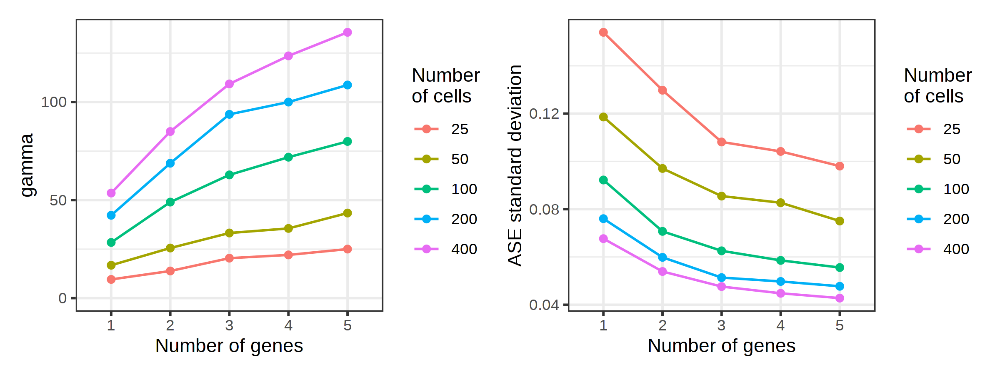

In [1176]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

df_gamma = D %>% 
    filter(set_size <= 5 & set_size > 0) %>%
    group_by(set_size, n_cells) %>% 
    summarise(
        gamma = fit_gamma(MD, DP),
        std = sqrt(bbinom_variance(gamma)),
        .groups = 'drop'
    ) %>%
    mutate(
        n_cells = factor(n_cells),
        set_size = factor(set_size)
    )

p1 = ggplot(
        df_gamma,
        aes(x = set_size, y = std, color = n_cells, group = n_cells)
    ) +
    geom_line() +
    geom_point() +
    theme_bw() +
    ylab('ASE standard deviation') +
    guides(color = guide_legend(title = 'Number\nof cells')) +
    xlab('Number of genes')

p2 = ggplot(
        df_gamma,
        aes(x = set_size, y = gamma, color = n_cells, group = n_cells)
    ) +
#     geom_boxplot(aes(group = set_size)) +
    geom_line() +
    geom_point() +
    theme_bw() +
    ylab('gamma') +
    guides(color = guide_legend(title = 'Number\nof cells')) +
    xlab('Number of genes') +
    ylim(0,NA)

p2 | p1

# Serial dilution visualization

In [1225]:
set.seed(0)

nodes = list()

n = 1150
ratios = seq(0, 1, 0.1)
seed = 1
panel = 'topmed'

for (r in ratios) {
    
        set.seed(seed)

        cells_tumor = cell_annot[['TNBC4']] %>% 
            filter(annot == 'T') %>%
            pull(cell) %>% sample(n * r)

        cells_normal = cell_annot[['TNBC4']] %>%
            filter(annot == 'N') %>% 
            pull(cell) %>% sample(n * (1-r))

        nodes[[as.character(r)]] = list(cells = c(cells_tumor, cells_normal), members = seed, label = r, size = n)
    
}

In [1234]:
bulks_serial = mclapply(
    nodes,
    mc.cores = 1,
    function(g) {

        bulk = get_allele_bulk(
            df = df[[panel]] %>% filter(cell %in% g$cells),
            genetic_map = genetic_map_hg38,
            min_depth = 0,
            lambda = 1
        ) %>%
        mutate(
            n_cells = g$size,
            seed = g$members,
            ratio = g$label
        ) %>%
        annot_consensus(segs_consensus) 

})

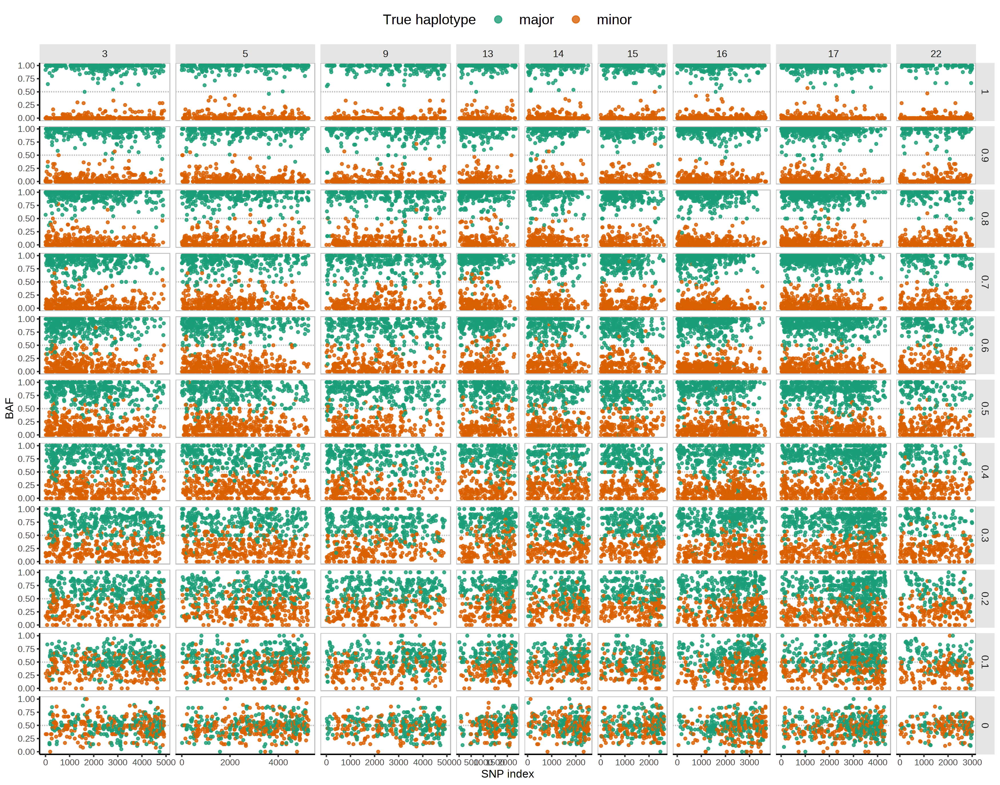

In [84]:
options(repr.plot.width = 14, repr.plot.height = 11, repr.plot.res = 250)

pal2 = RColorBrewer::brewer.pal(n = 8, 'Dark2')

bind_rows(bulks_serial) %>%
filter(CHROM %in% chroms & cnv_state == 'loh_2') %>%
arrange(-ratio) %>%
mutate(ratio = factor(ratio, unique(ratio))) %>%
inner_join(haplo_truth, by = c('snp_id', 'CHROM')) %>%
filter(DP > 5) %>%
group_by(CHROM) %>%
arrange(CHROM, POS) %>%
mutate(snp_index = as.integer(factor(snp_index, unique(snp_index)))) %>%
ungroup() %>%
ggplot(
    aes(x = snp_index, y = AR, color = haplo_truth),
    na.rm=TRUE
) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray') +
geom_point(
    alpha = 0.8,
    size = 1
) +
theme_classic() +
theme(
    panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
    strip.background = element_rect(fill = 'gray90', size = 0),
    strip.text = element_text(size = 10),
    legend.position = 'top',
    legend.title = element_text(size=14),
    legend.text = element_text(size=14),
) +
scale_shape_manual(values = c(1,4)) +
scale_size_manual(values = c(1,3)) +
scale_color_manual(values = c(pal2[1], pal2[2])) +
guides(
    color = guide_legend(
        title = 'True haplotype',
        override.aes = aes(size = 3),
        keywidth = unit(1, 'cm')
    ),
    size = 'none'
) +
ylab('BAF') +
xlab('SNP index') +
facet_grid(ratio~CHROM, scale = 'free_x', space = 'free_x')

In [1228]:
haplo_truth_amp = bulk_tumor %>%
    annot_consensus(segs_consensus_amp) %>%
    filter(!is.na(AD)) %>%
    mutate(haplo_truth = ifelse(AR < 0.5, 'minor', 'major')) %>%
    select(CHROM, snp_id, haplo_truth, AD, DP, AR)

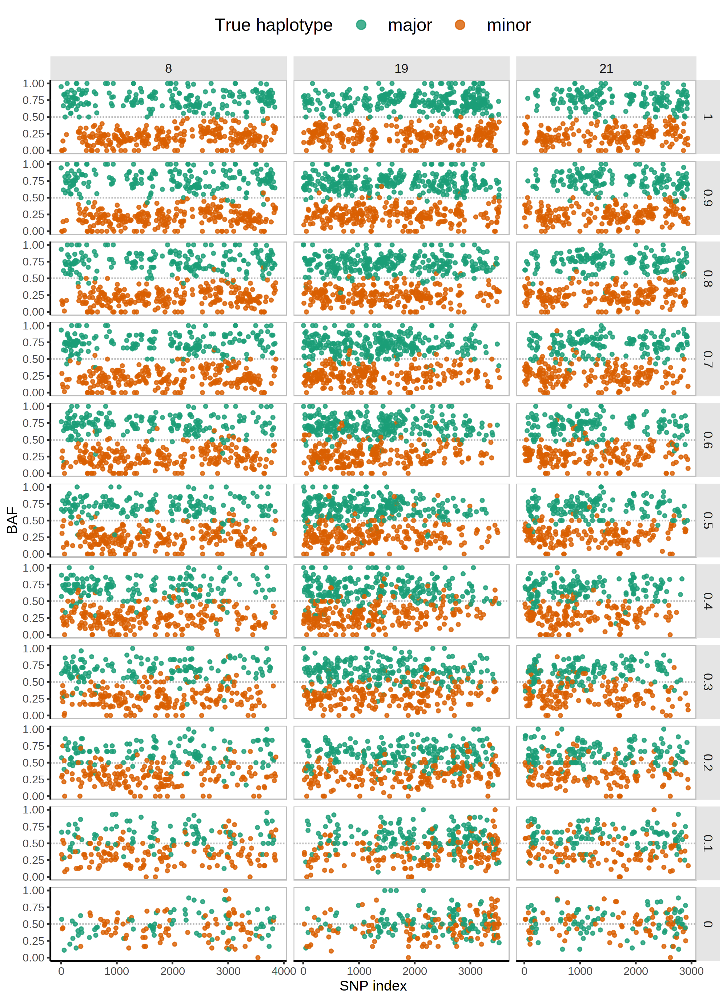

In [1241]:
options(repr.plot.width = 8, repr.plot.height = 11, repr.plot.res = 250)

pal2 = RColorBrewer::brewer.pal(n = 8, 'Dark2')

bind_rows(bulks_serial) %>%
arrange(-ratio) %>%
mutate(ratio = factor(ratio, unique(ratio))) %>%
inner_join(
    haplo_truth_amp %>% select(snp_id, CHROM, haplo_truth),
    by = c('snp_id', 'CHROM')
) %>%
filter(DP > 5) %>%
group_by(CHROM) %>%
arrange(CHROM, POS) %>%
mutate(snp_index = as.integer(factor(snp_index, unique(snp_index)))) %>%
ungroup() %>%
ggplot(
    aes(x = snp_index, y = AR, color = haplo_truth),
    na.rm=TRUE
) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray') +
geom_point(
    alpha = 0.8,
    size = 1
) +
theme_classic() +
theme(
    panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
    strip.background = element_rect(fill = 'gray90', size = 0),
    strip.text = element_text(size = 10),
    legend.position = 'top',
    legend.title = element_text(size=14),
    legend.text = element_text(size=14),
) +
scale_shape_manual(values = c(1,4)) +
scale_size_manual(values = c(1,3)) +
scale_color_manual(values = c(pal2[1], pal2[2])) +
guides(
    color = guide_legend(
        title = 'True haplotype',
        override.aes = aes(size = 3),
        keywidth = unit(1, 'cm')
    ),
    size = 'none'
) +
ylab('BAF') +
xlab('SNP index') +
facet_grid(ratio~CHROM, scale = 'free_x', space = 'free_x')

# Event calling

## LOH

In [274]:
sample = 'TNBC4'
out_dir = glue('~/paper_data/numbat_out/TNBC4')
allele_post = fread(glue('{out_dir}/allele_post_2.tsv'))

# some normal cells seem to harbor chr14 LoH
cells_exclude = allele_post %>% 
    left_join(cell_annot[['TNBC4']], by = 'cell') %>%
    filter(seg == '14_1') %>%
    filter(annot == 'N' & p_cnv > 0.999) %>%
    pull(cell)

In [133]:
set.seed(0)

nodes = list()

n_cells = 1150

ratios = seq(0, 0.15, 0.01)

for (r in ratios) {
    
    for (s in 1:5) {
        
        set.seed(s)
        
        cells_tumor = cell_annot[['TNBC4']] %>% 
            filter(annot == 'T') %>%
            pull(cell) %>% sample(n_cells * r)
    
        cells_normal = cell_annot[['TNBC4']] %>%
            filter(annot == 'N' & (!cell %in% cells_exclude)) %>% 
            pull(cell) %>% sample(n_cells * (1-r))

        nodes[[paste0(r, '_', s)]] = list(cells = c(cells_tumor, cells_normal), members = s, label = r, n_cells = n_cells)
    }
}

In [137]:
R.utils::sourceDirectory('~/Numbat/R')

diploid_chroms = c(14,15)
panels = c('topmed', '1000G')
bulks_event = list()
lambda = 1

# pseudobulks with different tumor fractions
for (panel in panels) {
    bulks_event[[panel]] = mclapply(
        nodes,
        mc.cores = 30,
        function(g) {
            get_bulk(
                count_mat = count_mat[,g$cells],
                df = df[[panel]] %>% filter(cell %in% g$cells),
                lambdas_ref = ref_hca,
                gtf_transcript = gtf_transcript,
                genetic_map = genetic_map_hg38,
                min_depth = 0,
                lambda = lambda
            ) %>%
            mutate(
                n_cells = g$size,
                seed = g$members,
                ratio = g$label
            )
    })
}

In [ ]:
theta_mle_naive = function(MAD, DP, lower = 0.0001, upper = 0.4999, start = 0.25, gamma = 20) {

    fit = optim(
        start, 
        function(theta) {-l_bbinom(MAD, DP, gamma*(0.5+theta), gamma*(0.5-theta))},
        method = 'L-BFGS-B',
        lower = lower,
        upper = upper,
        hessian = TRUE
    )
    
    mu = fit$par
    sigma = sqrt(as.numeric(1/(fit$hessian)))

    if (is.na(sigma)) {
        sigma = 0
    }
    
    return(tibble('theta_mle' = mu, 'theta_sigma' = sigma))
}

In [844]:
segs_consensus_loh = segs_consensus %>% filter(cnv_state == 'loh_2' & CHROM %in% chroms) 

In [846]:
ls = c(250)

set.seed(0)
segs_loh = list()
panels = c('topmed', '1000G')
ncores = 10

for (panel in panels) {
    
    display(panel)
    # different cell mixtures
    segs_loh[[panel]] = mclapply(
        mc.cores = ncores,
        bulks_event[[panel]],
        function(bulk) {
            # different chroms                        
            lapply(
                unique(segs_consensus_loh$CHROM),
                function(chr) {
                    # different segment lengths
                    lapply(
                        ls,
                        function(l) {
                            
                            n_cells = unique(bulk$n_cells)
                            seed = unique(bulk$seed)
                            
                            segs_mixture = bulk %>%
                                annot_consensus(segs_consensus_loh) %>%
                                filter(CHROM == chr) %>%
                                filter(!is.na(AD)) %>% 
                                sample_segs(n = 10, l = l)
                            
                            segs_normal = bulks_event[[panel]][[paste0(n_cells, '_0_', seed)]] %>%
                                filter(CHROM == chr) %>% 
                                filter(!is.na(AD)) %>% 
                                sample_segs(n = 10, l = l) %>%
                                mutate(ratio = unique(bulk$ratio)) # don't change
                            
                            segs = bind_rows(
                                    segs_mixture %>% mutate(label = 1),
                                    segs_normal %>% mutate(label = 0)
                                ) %>%
                                mutate(MAD = ifelse(AD >= DP - AD, AD, DP-AD))

                            segs = segs %>% mutate(chr = chr, l = l)

                            return(segs)

                        }
                    ) %>% 
                    bind_rows()
                }
            ) %>% 
            bind_rows()
        }
    ) %>% bind_rows()
    
}

[1] "topmed"

[1] "1000G"

In [850]:
R.utils::sourceDirectory('~/Numbat/R')

scores_loh = list()
gamma = 20
ncores = 15

for (panel in panels) {
    
    display(panel)
    
    theta_neu = segs_loh[[panel]] %>%
        filter(ratio == 0 & id_random == 1) %>%
        group_by(n_cells) %>%
        summarise(
            theta_mle_naive(MAD, DP),
            .groups = 'drop'
        ) %>%
        {setNames(.$theta_mle, .$n_cells)}
    
    segs_loh[[panel]] = segs_loh[[panel]] %>%
        mutate(theta_neu = theta_neu[as.character(n_cells)])
    
    display(theta_neu)

    scores_loh[[panel]] = segs_loh[[panel]] %>%
        mutate(chr = factor(chr)) %>%
        split(list(.$id_random, .$chr, .$seed)) %>%
        mclapply(
            mc.cores = ncores,
            function(bulk_seg) {
                                
                scores_phasing = bulk_seg %>% 
                    group_by(id_random, ratio, n_cells, seed, chr, l, label) %>%
                    summarise(
                        approx_theta_post(pAD, DP, p_s, gamma = gamma),
                        LLR = calc_allele_LLR(
                            pAD[!is.na(pAD)], DP[!is.na(pAD)], p_s[!is.na(pAD)], theta_mle, theta_0 = theta_0, gamma = unique(gamma)
                        ),
                        start_random = unique(start_random),
                        end_random = unique(end_random),
                        .groups = 'drop'
                    )
                
                scores_naive = bulk_seg %>%
                    group_by(id_random, ratio, n_cells, seed, chr, l, label) %>%
                    summarise(
                        theta_mle_naive(MAD, DP),
                        LLR = l_bbinom(MAD, DP, gamma*(0.5+theta_mle), gamma*(0.5-theta_mle)) - 
                            l_bbinom(
                                MAD, DP, gamma*(0.5+unique(theta_neu)),
                                gamma*(0.5-unique(theta_neu))
                            ),
                        start_random = unique(start_random),
                        end_random = unique(end_random),
                        .groups = 'drop'
                    )

                scores = bind_rows(
                    scores_phasing %>% mutate(method = 'phasing'),
                    scores_naive %>% mutate(method = 'naive')
                )
            }
        ) %>%
        bind_rows()
    
}

[1] "topmed"

250       500      1150 
0.2803919 0.2283364 0.1643120

[1] "1000G"

250       500      1150 
0.2817562 0.2331153 0.1653468

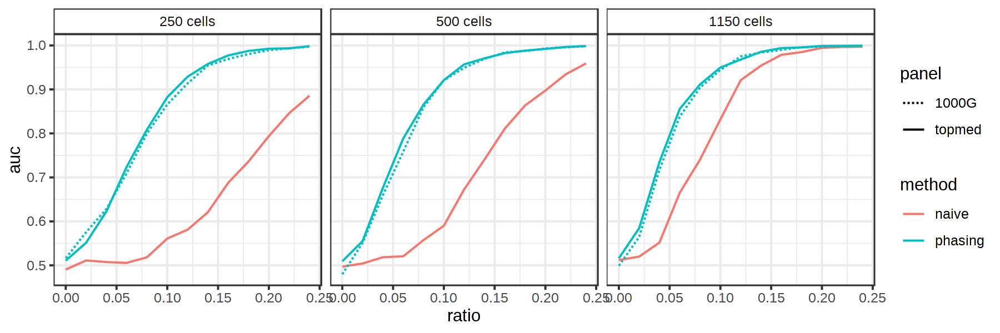

In [881]:
options(repr.plot.width = 9, repr.plot.height = 3, repr.plot.res = 200)
#lambda=1
rbind(
    scores_loh[['topmed']] %>% mutate(panel = 'topmed'),
    scores_loh[['1000G']] %>% mutate(panel = '1000G')
) %>%
group_by(method, panel, ratio, n_cells, l) %>%
mutate(panel = ifelse(method == 'naive', 'topmed', panel)) %>%
summarise(
     auc = as.numeric(pROC::auc(label, LLR, direction = '<', levels = levels(as.factor(label)))),
    .groups = 'drop'
) %>%
mutate(n_cells = glue("{n_cells} cells")) %>%
mutate(n_cells = factor(n_cells, unique(n_cells))) %>%
ggplot(
) + 
geom_line(aes(x = ratio, y = auc, color = method, linetype = panel)) +
theme_bw() +
theme(
    strip.background = element_rect(fill = NA)
) +
scale_linetype_manual(values = c('dashed', 'solid')) +
facet_wrap(~n_cells, nrow = 1)

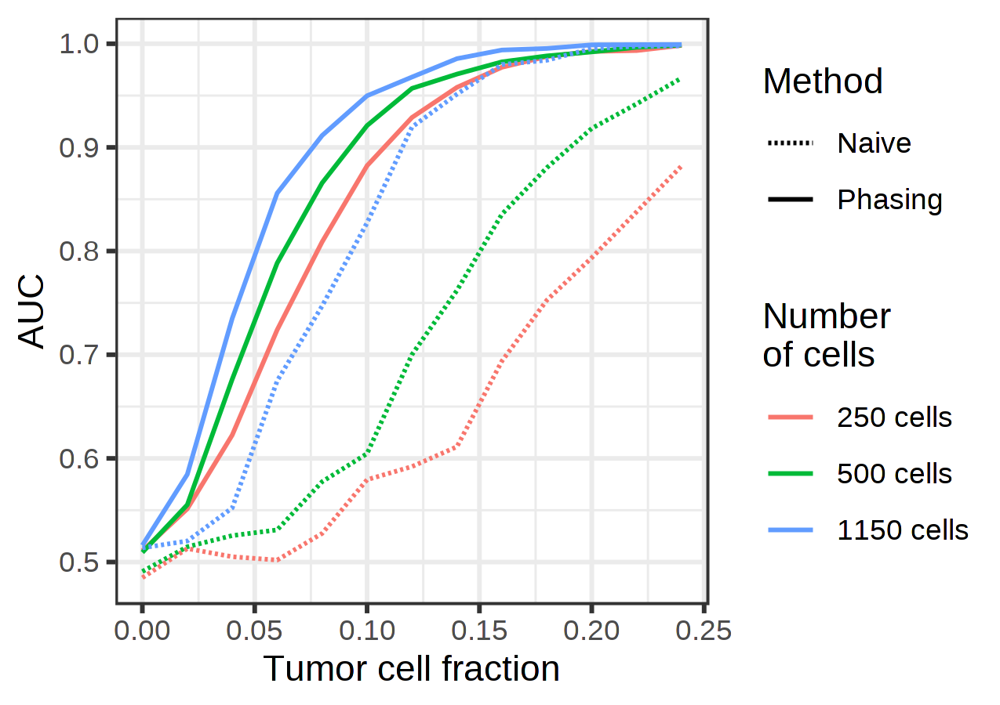

In [896]:
options(repr.plot.width = 4.25, repr.plot.height = 3, repr.plot.res = 300)
#lambda=1
scores_loh[['topmed']] %>%
group_by(method, ratio, n_cells, l) %>%
summarise(
     auc = as.numeric(pROC::auc(label, LLR, direction = '<', levels = levels(as.factor(label)))),
    .groups = 'drop'
) %>%
mutate(n_cells = glue("{n_cells} cells")) %>%
mutate(n_cells = factor(n_cells, unique(n_cells))) %>%
mutate(method = str_to_sentence(method)) %>%
ggplot(
) + 
geom_line(aes(x = ratio, y = auc, color = n_cells, linetype = method)) +
theme_bw() +
theme(
    strip.background = element_rect(fill = NA)
) +
scale_linetype_manual(values = c('dashed', 'solid')) +
guides(
    color = guide_legend('Number\nof cells'),
    linetype = guide_legend('Method')
) +
xlab('Tumor cell fraction') +
ylab('AUC')

## Results

In [130]:
scores = readRDS('~/paper_data/phasing_benchmark/bulk_cnv_scores_jan.rds')
bulks_event = readRDS('~/paper_data/phasing_benchmark/bulks_event_jan.rds')

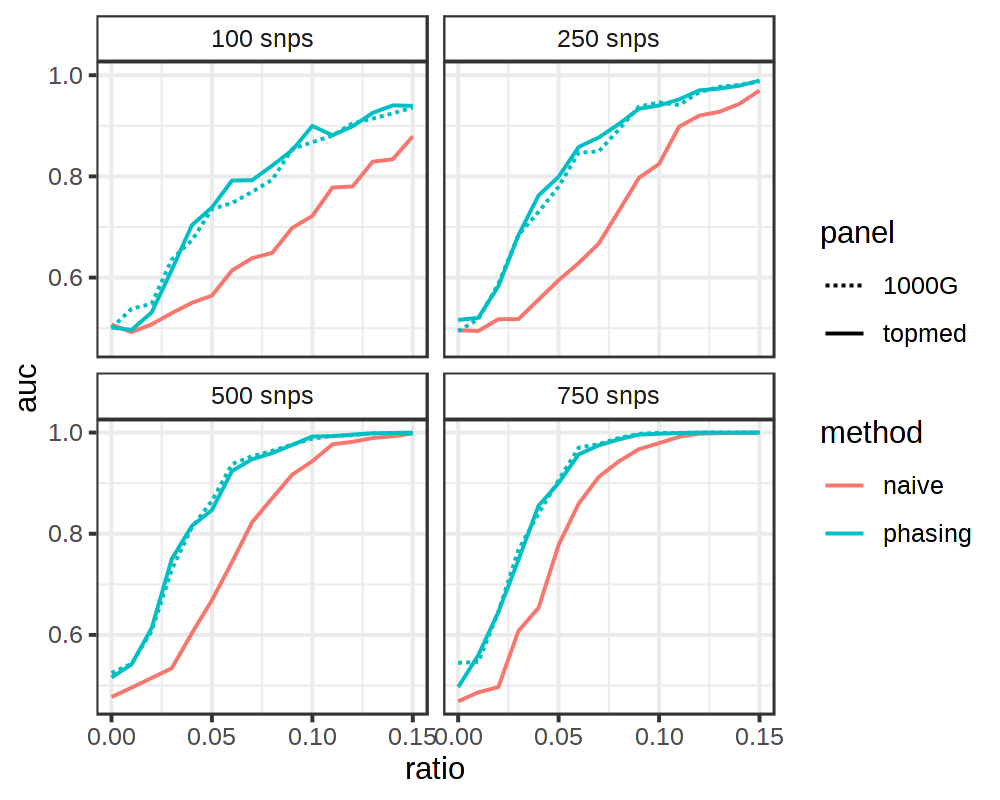

In [109]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 200)
#lambda=1
rbind(
    scores[['topmed']] %>% mutate(panel = 'topmed'),
    scores[['1000G']] %>% mutate(panel = '1000G')
) %>%
group_by(method, panel, ratio, l) %>%
mutate(panel = ifelse(method == 'naive', 'topmed', panel)) %>%
summarise(
     auc = as.numeric(pROC::auc(label, LLR, direction = '<', levels = levels(as.factor(label)))),
    .groups = 'drop'
) %>%
mutate(l = glue("{l} snps")) %>%
ggplot(
) + 
geom_line(aes(x = ratio, y = auc, color = method, linetype = panel)) +
theme_bw() +
theme(
    strip.background = element_rect(fill = NA)
) +
scale_linetype_manual(values = c('dashed', 'solid')) +
facet_wrap(~l, nrow = 2)

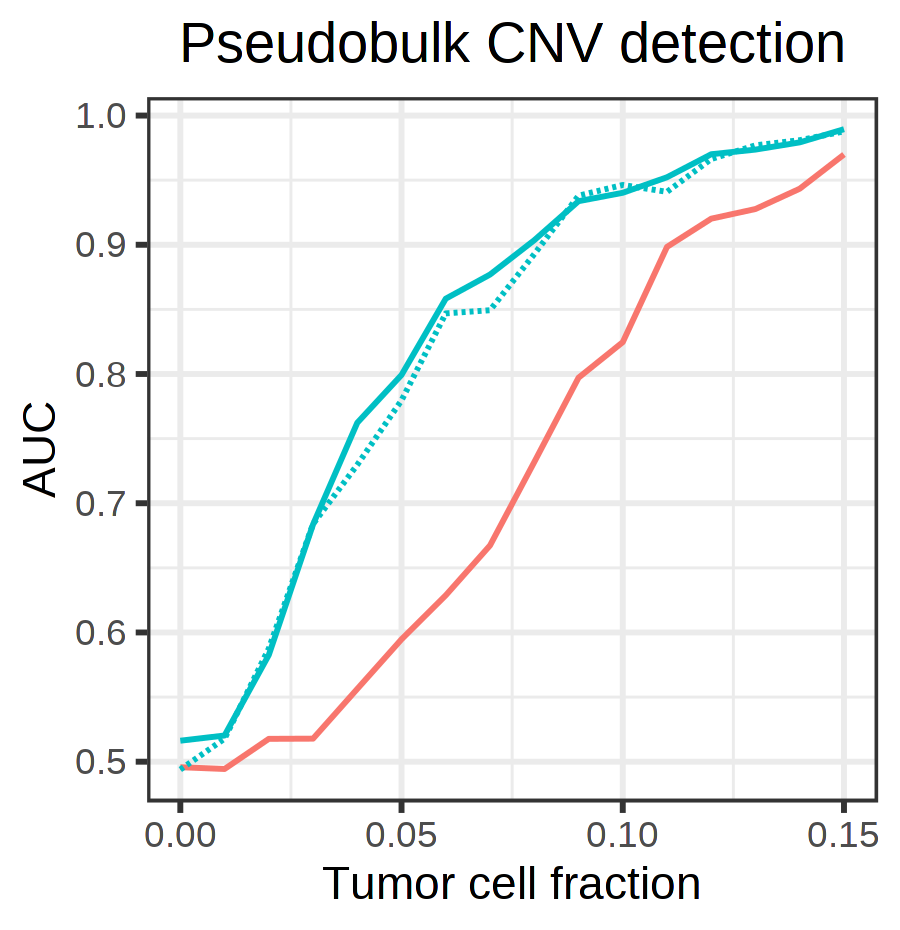

In [110]:
options(repr.plot.width = 3, repr.plot.height = 3.1, repr.plot.res = 300)

rbind(
    scores[['topmed']] %>% mutate(panel = 'topmed'),
    scores[['1000G']] %>% mutate(panel = '1000G')
) %>%
group_by(method, panel, ratio, l) %>%
mutate(panel = ifelse(method == 'naive', 'topmed', panel)) %>%
summarise(
     auc = as.numeric(pROC::auc(label, LLR, direction = '<', levels = levels(as.factor(label)))),
    .groups = 'drop'
) %>%
filter(l == 250) %>%
ggplot(
) + 
geom_line(aes(x = ratio, y = auc, color = method, linetype = panel)) +
theme_bw() +
theme(
    strip.background = element_rect(fill = NA),
    plot.title = element_text(hjust = 0.5),
    legend.position = 'none'
) +
scale_linetype_manual(values = c('dashed', 'solid')) +
xlab('Tumor cell fraction') +
ylab('AUC') +
ggtitle('Pseudobulk CNV detection')

## Illustration

In [116]:
plot_seg = function(start_random, end_random, chr, seed, ratios, min_depth = 5) {
    
    bulk_seg = bulks_event[['topmed']][paste0(ratios, '_', seed)] %>%
        lapply(function(bulk){
            bulk %>% 
                filter(CHROM == chr) %>%
                filter(snp_index <= end_random & snp_index >= start_random) %>%
                filter(!is.na(AD)) %>%
                analyze_bulk(classify_allele = T, retest = F, verbose = F, diploid_chroms = c(chr)) %>%
                annot_haplo_segs() %>%
                ungroup() %>%
                mutate(theta_hat_roll = theta_hat_roll(pAD, DP-pAD, h = 20)) %>%
                group_by(seg) %>%
                mutate(HF = sum(pAD)/sum(DP)) %>%
                ungroup()
        }) %>%
        bind_rows()
    
    LLRs = bulk_seg %>% 
        group_by(ratio) %>%
        mutate(MAD = ifelse(AD >= DP - AD, AD, DP-AD)) %>%
        summarise(
            approx_lik_ar(pAD, DP, p_s, gamma = gamma),
            phasing = calc_allele_LLR(
                pAD[!is.na(pAD)], DP[!is.na(pAD)], p_s[!is.na(pAD)], theta_mle, gamma = unique(gamma)
            ),
            theta_mle_naive(MAD, DP),
            naive = l_bbinom(MAD, DP, gamma*(0.5+theta_mle), gamma*(0.5-theta_mle)) - 
                l_bbinom(MAD, DP, gamma*(0.5+theta_neu), gamma*(0.5-theta_neu)),
        ) %>%
        reshape2::melt(measure.vars = c('phasing', 'naive'), variable.name = 'method', value.name = 'LLR') %>%
        mutate(variable = ifelse(method == 'phasing', 'pHF', 'BAF'))

    D = bulk_seg %>% 
        filter(DP >= min_depth) %>% 
        group_by(ratio) %>%
        mutate(snp_index = 1:n()) %>%
        ungroup() %>%
        rename(pHF = pBAF, BAF = AR) %>%
        reshape2::melt(measure.vars = c('pHF', 'BAF')) %>%
        mutate(state = ifelse(variable == 'BAF' | ratio == 0, 'neu_down', state)) %>%
        mutate(variable = factor(variable, c('BAF', 'pHF')))

    ggplot(
        D %>% filter(DP >= min_depth),
        aes(x = snp_index, y = value, color = state),
        na.rm=TRUE
    ) +
    geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray50') +
    geom_point(
        size = 1.2,
        alpha = 0.5,
        shape = 16
    ) +
    theme_classic() +
    theme(
        panel.spacing = unit(1, 'mm'),
        panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
#         strip.background = element_blank(),
        strip.background = element_rect(fill = 'gray90', size = 0)
    ) +
    geom_path(
        data = D %>% 
            filter(ratio != 0 & variable == 'pHF'),
        aes(x = snp_index, y = HF, group = seg, color = state),
        lineend = 'round', 
        color = 'darkred', 
        linetype = 'dashed',
        size = 0.3
    ) +
    geom_text(
        data = LLRs,
        inherit.aes = F,
        aes(x = 1, y = 0, label = paste0('LLR=', round(LLR, 2))),
        size = 3.5,
        hjust = 0,
        vjust = 0
    ) +
    facet_grid(ratio ~ variable, scale = 'free_x', space = 'free_x') +
    guides(color = "none", fill = FALSE, alpha = FALSE, shape = FALSE) +
    ylim(0,1) +
    scale_color_manual(values = cnv_colors) +
    scale_x_continuous(expand = expansion(add = 1))
}

seed,chr,l,label,ratio,id_random,start_random,end_random,naive,phasing
<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<dbl>
1,3,250,1,0.05,5,1335,1585,0.1338976,1.270847
1,3,250,1,0.10,5,102,352,0.3363064,11.493967
1,3,250,1,0.15,5,412,662,7.6844915,11.510533


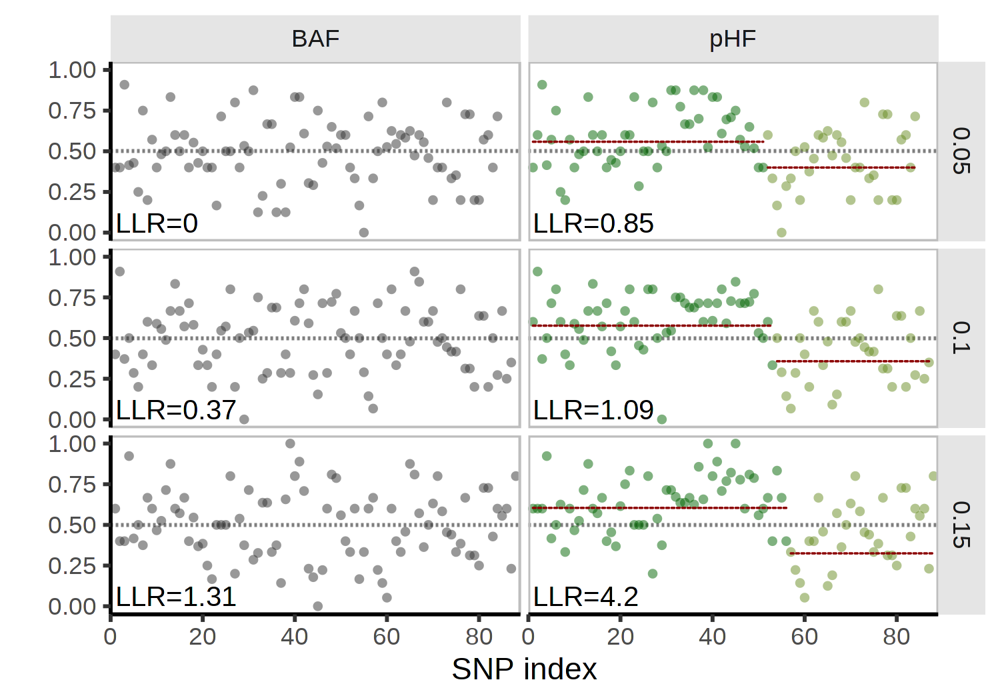

In [129]:
options(repr.plot.width = 5, repr.plot.height = 3.5, repr.plot.res = 300)

seg = readRDS('~/paper_data/phasing_benchmark/seg_illustration.rds')

ratios = c(0.05, 0.1, 0.15)
theta_neu = 0.166062474189259

plot_seg(
    start_random = seg$start_random, 
    end_random = seg$end_random, 
    chr = seg$chr,
    seed = seg$seed,
    ratios = ratios,
    min_depth = 5
) +
ylab('') +
xlab('SNP index')

scores[['topmed']] %>% 
    filter(ratio %in% ratios & label == 1 & id_random == seg$id_random & chr == seg$chr & seed == seg$seed & l == seg$l) %>%
    reshape2::dcast(seed + chr + l + label + ratio + id_random + start_random + end_random ~ method, value.var = 'LLR') %>%
    display

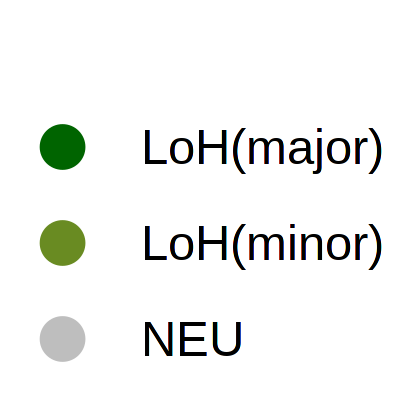

In [1143]:
options(repr.plot.width = 1, repr.plot.height = 1, repr.plot.res = 400)

p = data.frame(
        state = c('LoH(major)', 'LoH(minor)', 'NEU')
    ) %>%
    ggplot(
        aes(x = 1, y = 1, color = state)
    ) +
    geom_point() +
    scale_color_manual(
        values = c(cnv_colors[['loh_up']], cnv_colors[['loh_down']], cnv_colors[['neu']])
    ) +
    guides(color = guide_legend(title = "", override.aes = aes(size = 3))) +
    theme_classic()

as_ggplot(get_legend(p))

In [1112]:
start_random = seg$start_random
end_random = seg$end_random
chr = seg$chr
seed = seg$seed
ratios = c(0.05, 0.1, 0.15)

bulk_seg = bulks_event[['topmed']][paste0(ratios, '_', seed)] %>%
    lapply(function(bulk){
        bulk %>% 
            filter(CHROM == chr) %>%
            filter(snp_index <= end_random & snp_index >= start_random) %>%
            filter(!is.na(AD)) %>%
            analyze_bulk(classify_allele = T, retest = F, verbose = F, diploid_chroms = c(chr)) %>%
            annot_haplo_segs() %>%
            group_by(seg) %>%
            mutate(HF = sum(pAD)/sum(DP)) %>%
            ungroup()
    }) %>%
    bind_rows()

LLRs = bulk_seg %>% 
    group_by(ratio) %>%
    mutate(MAD = ifelse(AD >= DP - AD, AD, DP-AD)) %>%
    summarise(
        approx_lik_ar(pAD, DP, p_s, gamma = gamma),
        phasing = calc_allele_LLR(
            pAD[!is.na(pAD)], DP[!is.na(pAD)], p_s[!is.na(pAD)], theta_mle, gamma = unique(gamma)
        ),
        theta_mle_naive(MAD, DP),
        naive = l_bbinom(MAD, DP, gamma*(0.5+theta_mle), gamma*(0.5-theta_mle)) - 
            l_bbinom(MAD, DP, gamma*(0.5+theta_neu), gamma*(0.5-theta_neu)),
    ) %>%
    reshape2::melt(measure.vars = c('phasing', 'naive'), variable.name = 'method', value.name = 'LLR')

LLRs

ratio,theta_mle,theta_sigma,method,LLR
<dbl>,<dbl>,<dbl>,<fct>,<dbl>
0.05,0.1649968,0.01538209,phasing,0.854352362
0.10,0.1790380,0.01493998,phasing,1.091826079
0.15,0.1903457,0.01481607,phasing,4.198776786
0.05,0.1649968,0.01538209,naive,0.002402114
0.10,0.1790380,0.01493998,naive,0.372743406
0.15,0.1903457,0.01481607,naive,1.311667456


In [1004]:
segs_sample = scores[['topmed']] %>% 
    filter(ratio == 0.1 & label == 1) %>%
    distinct(chr, start_random, end_random, method, `.keep_all` = T) %>%
    reshape2::dcast(seed + chr + l + label + id_random + start_random + end_random ~ method, value.var = 'LLR') %>%
    filter(phasing > 10 & naive < 1 & l == 250) %>%
    arrange(-phasing) %>%
    distinct(chr, .keep_all = T)

segs_sample

seed,chr,l,label,id_random,start_random,end_random,naive,phasing
<int>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<dbl>
4,16,250,1,6,848,1098,0.9251389,22.76219
2,22,250,1,3,257,507,0.3344667,21.00204
3,9,250,1,6,265,515,0.9147560,20.22886
3,15,250,1,4,597,847,0.8418012,16.52490
4,5,250,1,8,906,1156,0.5720497,16.42569
1,14,250,1,5,1134,1384,0.0930753,14.47576
3,13,250,1,9,828,1078,0.0209031,13.20513
1,3,250,1,5,102,352,0.3363064,11.49397


In [972]:
# saveRDS(scores, '~/results/benchmark/bulk_cnv_scores_jan.rds')
# saveRDS(bulks_event, '~/results/benchmark/bulks_event_jan.rds')

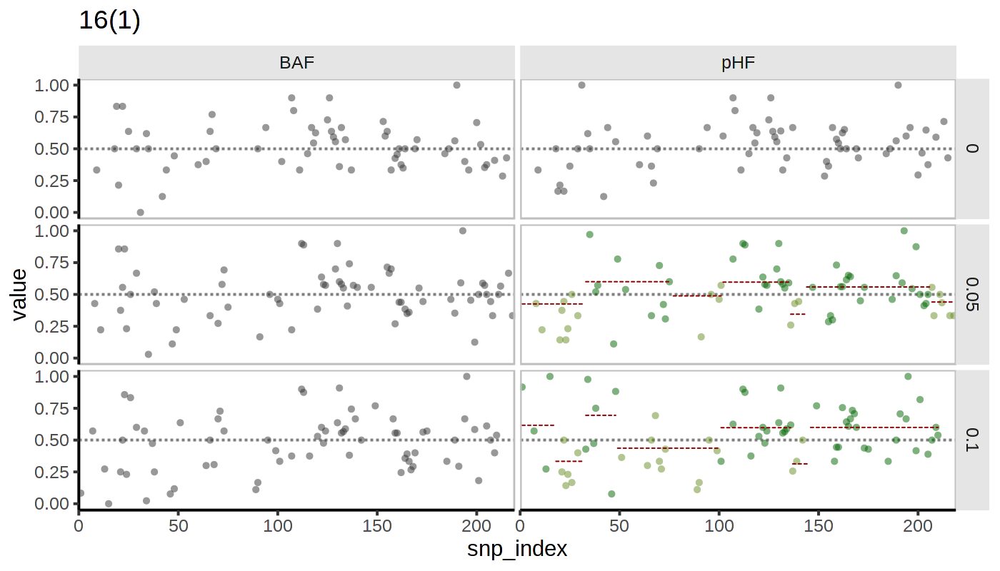

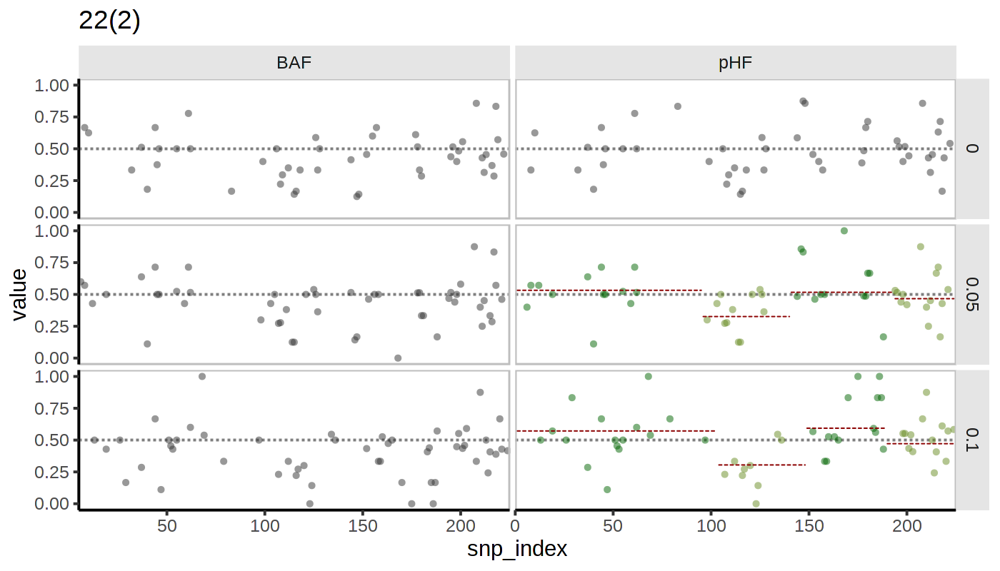

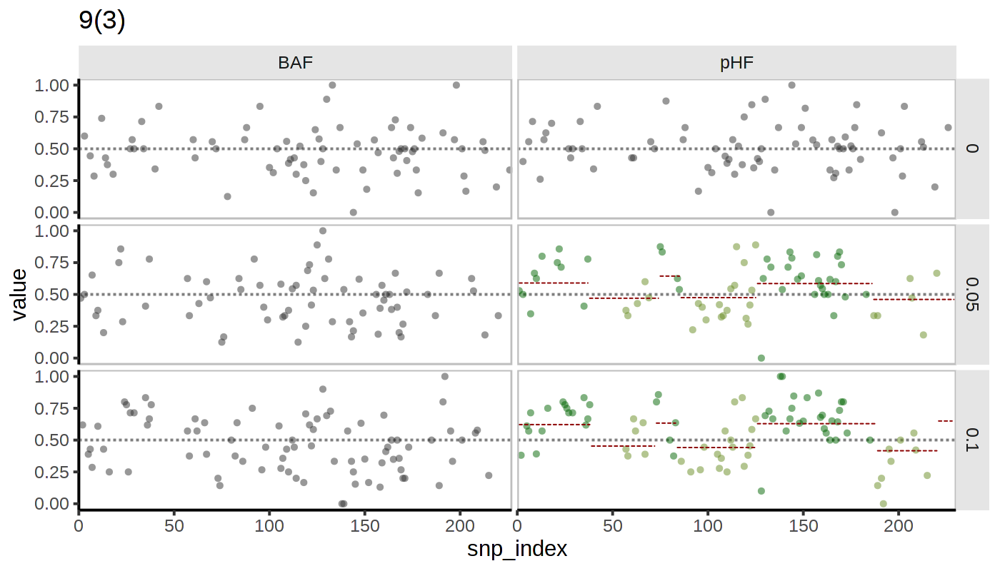

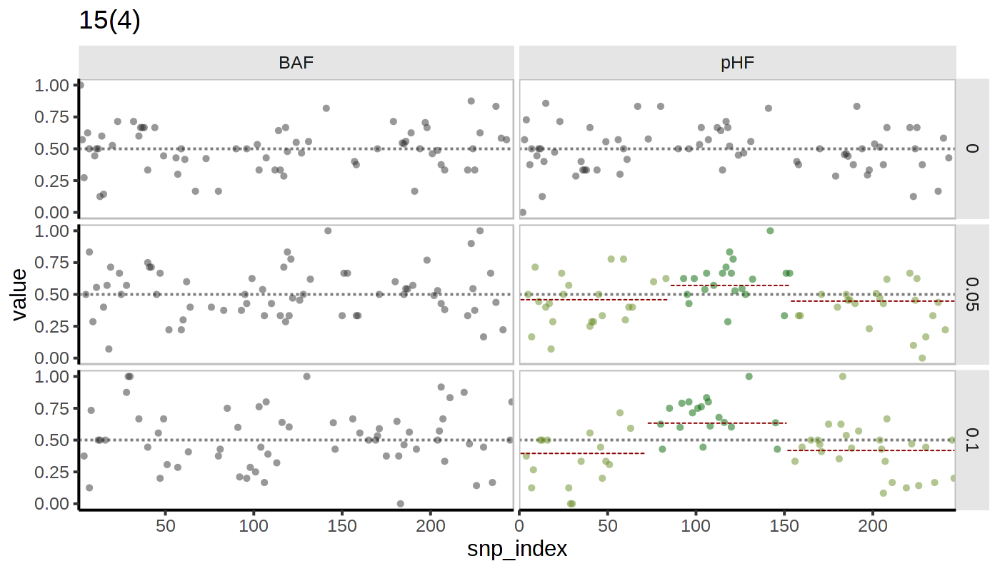

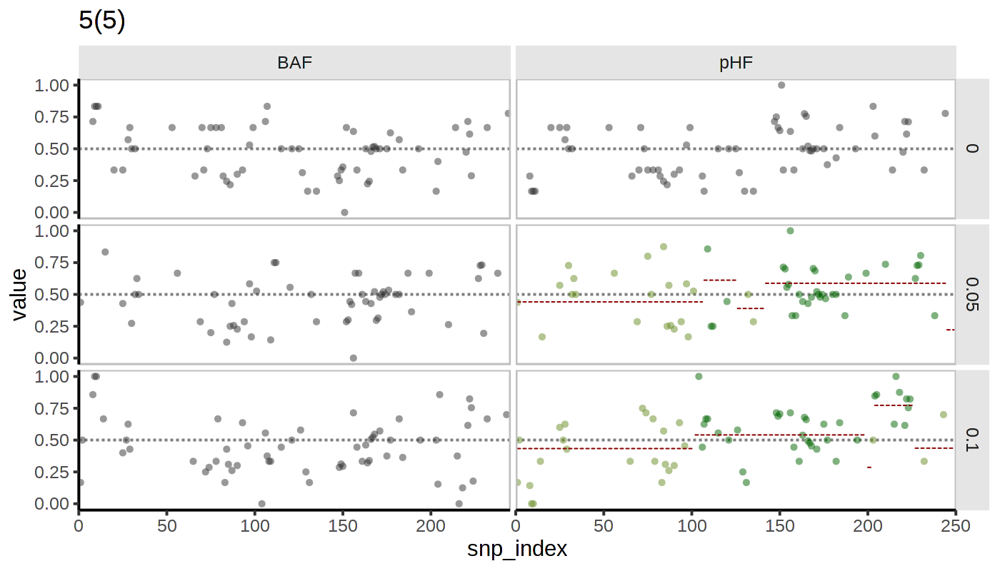

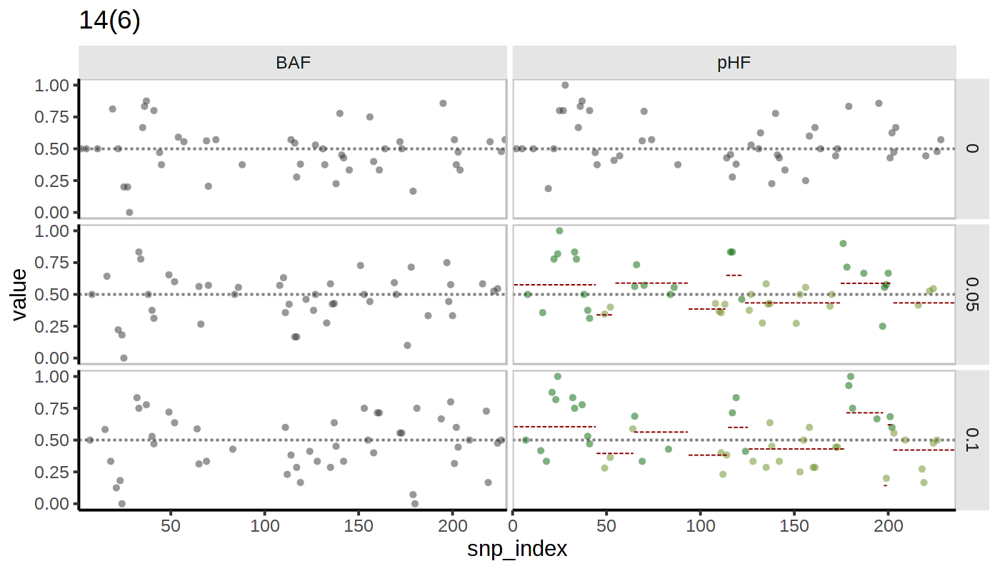

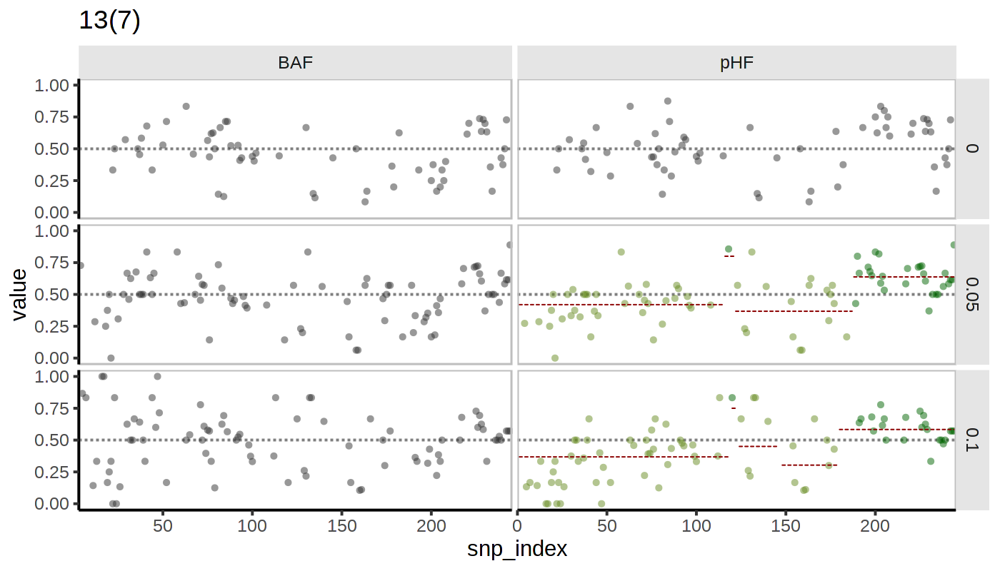

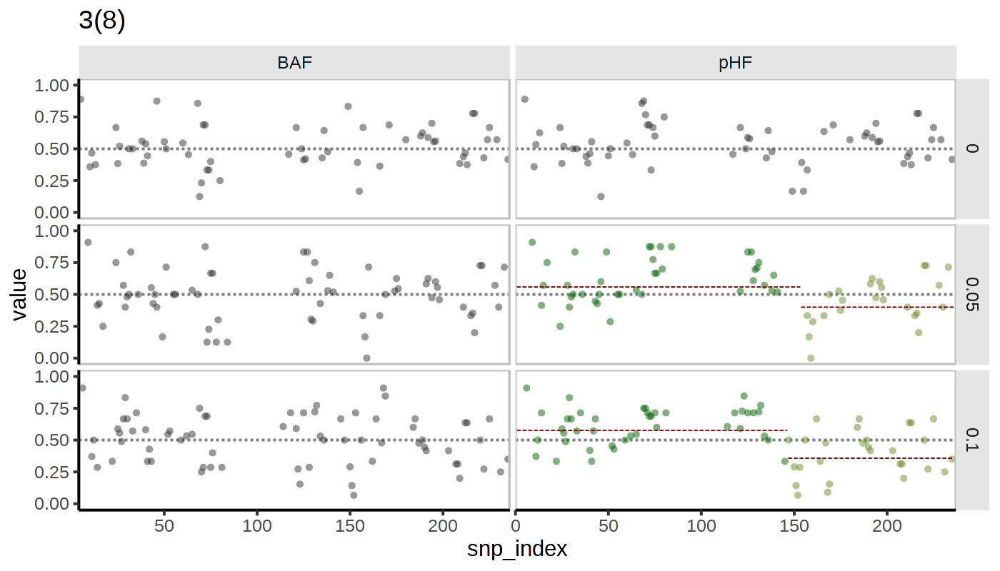

In [1006]:
options(repr.plot.width = 7, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

for (i in 1:nrow(segs_sample)) {
    
    seg = segs_sample[i,]
    
    p = plot_seg(
        start_random = seg$start_random, 
        end_random = seg$end_random, 
        chr = seg$chr,
        seed = seg$seed,
        ratios =  c(0, 0.05, 0.1)
    ) + 
    ggtitle(paste0(seg$chr, '(', i, ')'))
    
    display(p)
    
}

## Amplifications

In [1227]:
segs_consensus_amp = data.frame(
    CHROM = c(8, 19, 21),
    seg_start = c(47200000, 28100000, 5116341),
    seg_end = c(145138636, 58617616, 46709983),
    cnv_state = 'amp'
) %>%
mutate(
    CHROM = factor(CHROM, 1:22),
    seg = 1:n(), 
    seg_cons = seg,
    p_loh = 0, p_amp = 1, p_del = 0, p_bamp = 0, p_bdel = 0,
    cnv_state_post = cnv_state
)

In [835]:
set.seed(0)

nodes = list()

n_cells = c(250, 500, 1150)
# n_cells = c(200)

# ratios = seq(0, 0.15, 0.01)
ratios = seq(0, 0.25, 0.02)

for (n in n_cells) {
    
    for (r in ratios) {

        for (s in 1:10) {

            set.seed(s)

            cells_tumor = cell_annot[['TNBC4']] %>% 
                filter(annot == 'T') %>%
                pull(cell) %>% sample(n * r)

            cells_normal = cell_annot[['TNBC4']] %>%
                filter(annot == 'N' & (!cell %in% cells_exclude)) %>% 
                pull(cell) %>% sample(n * (1-r))

            nodes[[paste0(n, '_', r, '_', s)]] = list(cells = c(cells_tumor, cells_normal), members = s, label = r, n_cells = n)
        }
    }
    
}

In [836]:
R.utils::sourceDirectory('~/Numbat/R')

diploid_chroms = c(14,15)
panels = c('topmed', '1000G')
bulks_event = list()
lambda = 1
ncores = 20

# pseudobulks with different tumor fractions
for (panel in panels) {
    bulks_event[[panel]] = mclapply(
        nodes,
        mc.cores = ncores,
        function(g) {
            get_bulk(
                count_mat = count_mat[,g$cells],
                df = df[[panel]] %>% filter(cell %in% g$cells),
                lambdas_ref = ref_hca,
                gtf_transcript = gtf_hg38,
                genetic_map = genetic_map_hg38,
                min_depth = 0,
                lambda = lambda
            ) %>%
            mutate(
                n_cells = g$size,
                seed = g$members,
                ratio = g$label,
                n_cells = g$n_cells
            )
    })
}

In [ ]:
# bulks_event = readRDS('~/paper_data/phasing_benchmark/bulks_event_jan.rds')

In [798]:
# get random segments from the profile
sample_segs = function(bulk, l = 500, n = 10) {
    
    if (nrow(bulk) < l) {
        stop('not enough SNPs')
    }
    
    starts = sample(1:(nrow(bulk)-l), n)
        
    bulk_segs = lapply(
        1:length(starts),
        function(i) {
            start = starts[i]
            bulk[start:(start+l),] %>% mutate(start_random = start, end_random = start+l, id_random = i)
        }
    ) %>%
    bind_rows()
    
    return(bulk_segs)
    
}

In [837]:
ls = c(250)

set.seed(0)
segs_amp = list()
panels = c('topmed', '1000G')
ncores = 10

for (panel in panels) {
    
    display(panel)
    # different cell mixtures
    segs_amp[[panel]] = mclapply(
        mc.cores = ncores,
        bulks_event[[panel]],
        function(bulk) {
            # different chroms                        
            lapply(
                unique(segs_consensus_amp$CHROM),
                function(chr) {
                    # different segment lengths
                    lapply(
                        ls,
                        function(l) {
                            
                            n_cells = unique(bulk$n_cells)
                            seed = unique(bulk$seed)
                            
                            segs_mixture = bulk %>%
                                annot_consensus(segs_consensus_amp) %>%
                                filter(CHROM == chr) %>%
                                filter(!is.na(AD)) %>% 
                                sample_segs(n = 10, l = l)
                            
                            segs_normal = bulks_event[[panel]][[paste0(n_cells, '_0_', seed)]] %>%
                                filter(CHROM == chr) %>% 
                                filter(!is.na(AD)) %>% 
                                sample_segs(n = 10, l = l) %>%
                                mutate(ratio = unique(bulk$ratio)) # don't change
                            
                            segs = bind_rows(
                                    segs_mixture %>% mutate(label = 1),
                                    segs_normal %>% mutate(label = 0)
                                ) %>%
                                mutate(MAD = ifelse(AD >= DP - AD, AD, DP-AD))

                            segs = segs %>% mutate(chr = chr, l = l)

                            return(segs)

                        }
                    ) %>% 
                    bind_rows()
                }
            ) %>% 
            bind_rows()
        }
    ) %>% bind_rows()
    
}

[1] "topmed"

[1] "1000G"

In [838]:
R.utils::sourceDirectory('~/Numbat/R')

scores_amp = list()
gamma = 20
ncores = 35

for (panel in panels) {
    
    display(panel)
    
    theta_neu = segs_amp[[panel]] %>%
        filter(ratio == 0 & id_random == 1) %>%
        group_by(n_cells) %>%
        summarise(
            theta_mle_naive(MAD, DP),
            .groups = 'drop'
        ) %>%
        {setNames(.$theta_mle, .$n_cells)}
    
    segs_amp[[panel]] = segs_amp[[panel]] %>%
        mutate(theta_neu = theta_neu[as.character(n_cells)])
    
    display(theta_neu)

    scores_amp[[panel]] = segs_amp[[panel]] %>%
        mutate(chr = factor(chr)) %>%
        split(list(.$id_random, .$chr, .$seed)) %>%
        mclapply(
            mc.cores = ncores,
            function(bulk_seg) {
                                
                scores_phasing = bulk_seg %>% 
                    group_by(id_random, ratio, n_cells, seed, chr, l, label) %>%
                    summarise(
                        approx_theta_post(pAD, DP, p_s, gamma = gamma),
                        LLR = calc_allele_LLR(
                            pAD[!is.na(pAD)], DP[!is.na(pAD)], p_s[!is.na(pAD)], theta_mle, theta_0 = theta_0, gamma = unique(gamma)
                        ),
                        start_random = unique(start_random),
                        end_random = unique(end_random),
                        .groups = 'drop'
                    )
                
                scores_naive = bulk_seg %>%
                    group_by(id_random, ratio, n_cells, seed, chr, l, label) %>%
                    summarise(
                        theta_mle_naive(MAD, DP),
                        LLR = l_bbinom(MAD, DP, gamma*(0.5+theta_mle), gamma*(0.5-theta_mle)) - 
                            l_bbinom(
                                MAD, DP, gamma*(0.5+unique(theta_neu)),
                                gamma*(0.5-unique(theta_neu))
                            ),
                        start_random = unique(start_random),
                        end_random = unique(end_random),
                        .groups = 'drop'
                    )

                scores = bind_rows(
                    scores_phasing %>% mutate(method = 'phasing'),
                    scores_naive %>% mutate(method = 'naive')
                )
            }
        ) %>%
        bind_rows()
    
}

[1] "topmed"

250       500      1150 
0.2798529 0.2286663 0.1651275

[1] "1000G"

250       500      1150 
0.2806468 0.2289277 0.1630314

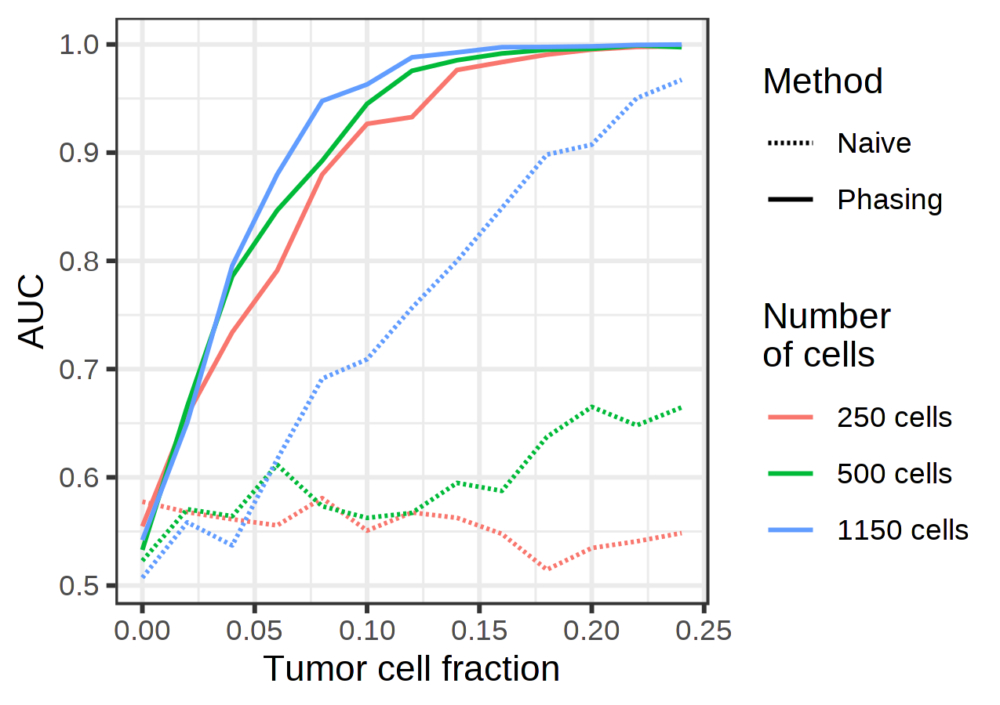

In [897]:
options(repr.plot.width = 4.25, repr.plot.height = 3, repr.plot.res = 300)
#lambda=1
scores_amp[['topmed']] %>%
group_by(method, ratio, n_cells, l) %>%
summarise(
     auc = as.numeric(pROC::auc(label, LLR, direction = '<', levels = levels(as.factor(label)))),
    .groups = 'drop'
) %>%
mutate(n_cells = glue("{n_cells} cells")) %>%
mutate(n_cells = factor(n_cells, unique(n_cells))) %>%
mutate(method = str_to_sentence(method)) %>%
ggplot(
) + 
geom_line(aes(x = ratio, y = auc, color = n_cells, linetype = method)) +
theme_bw() +
theme(
    strip.background = element_rect(fill = NA)
) +
scale_linetype_manual(values = c('dashed', 'solid')) +
guides(
    color = guide_legend('Number\nof cells'),
    linetype = guide_legend('Method')
) +
xlab('Tumor cell fraction') +
ylab('AUC')

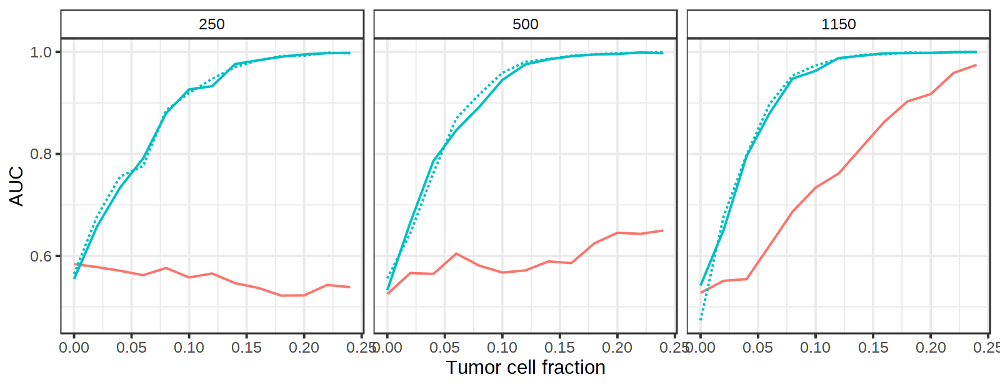

In [840]:
options(repr.plot.width = 8, repr.plot.height = 3.1, repr.plot.res = 200)

rbind(
    scores_amp[['topmed']] %>% mutate(panel = 'topmed'),
    scores_amp[['1000G']] %>% mutate(panel = '1000G')
) %>%
filter(l == 250) %>%
group_by(method, panel, ratio, n_cells, l) %>%
mutate(panel = ifelse(method == 'naive', 'topmed', panel)) %>%
summarise(
     auc = as.numeric(pROC::auc(label, LLR, direction = '<', levels = levels(as.factor(label)))),
    .groups = 'drop'
) %>%
ggplot(
) + 
geom_line(aes(x = ratio, y = auc, color = method, linetype = panel)) +
theme_bw() +
theme(
    strip.background = element_rect(fill = NA),
    plot.title = element_text(hjust = 0.5),
    legend.position = 'none'
) +
scale_linetype_manual(values = c('dashed', 'solid')) +
xlab('Tumor cell fraction') +
ylab('AUC') +
facet_wrap(~n_cells)

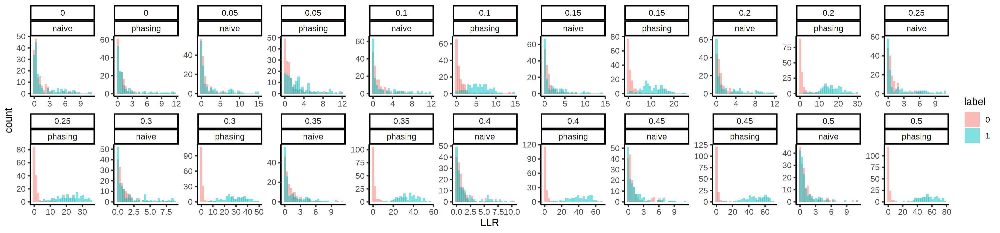

In [670]:
options(repr.plot.width = 15, repr.plot.height = 3.5, repr.plot.res = 200)

ggplot(
    scores_amp[['topmed']] %>% mutate(label = factor(label)),
    aes(x = LLR, fill = label)
) +
geom_histogram(position = 'identity', bins = 30, alpha = 0.5) +
theme_classic() +
facet_wrap(~ratio+method, scales = 'free', nrow = 2) +
theme()

# A tibble: 8 × 6
  ratio theta_mle theta_sigma    LLR method  variable
  <dbl>     <dbl>       <dbl>  <dbl> <chr>   <chr>   
1   0      0.0763      0.0403  0.732 phasing pHF     
2   0.1    0.108       0.0283  2.79  phasing pHF     
3   0.2    0.156       0.0221 14.7   phasing pHF     
4   0.4    0.199       0.0182 35.9   phasing pHF     
5   0      0.303       0.0218  9.16  naive   BAF     
6   0.1    0.281       0.0184  8.36  naive   BAF     
7   0.2    0.268       0.0169  7.33  naive   BAF     
8   0.4    0.279       0.0149 12.5   naive   BAF     


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


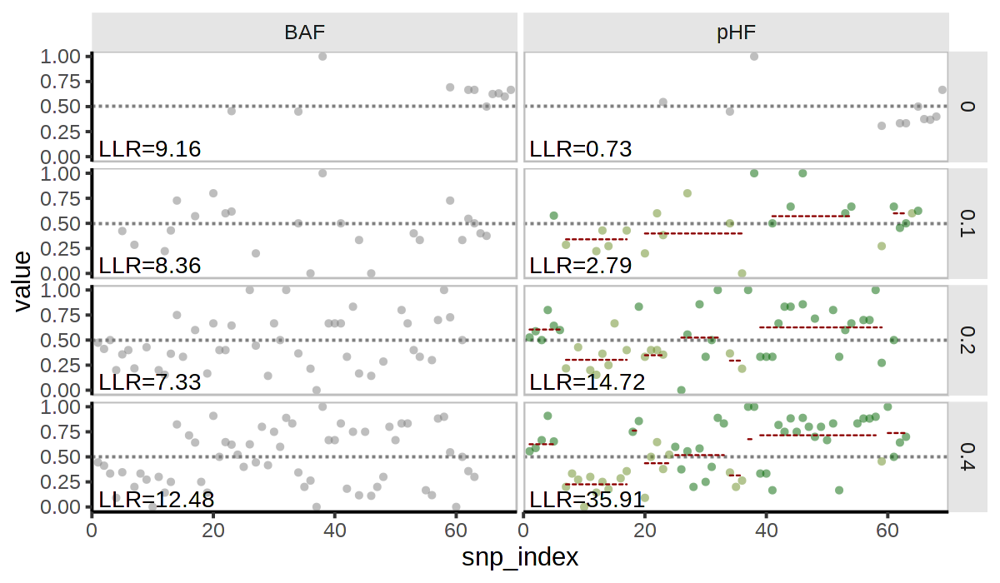

In [688]:
options(repr.plot.width = 6, repr.plot.height = 3.5, repr.plot.res = 200)

plot_seg(
    start_random = unique(seg$start_random), 
    end_random = unique(seg$end_random), 
    chr = unique(seg$chr),
    seed = unique(seg$seed),
    n_cells = unique(seg$n_cells),
    ratios = c(0, 0.1, 0.2, 0.4),
    segs_consensus = segs_consensus_amp,
    min_depth = 5,
    theta_neu = 0.2
)

In [512]:
R.utils::sourceDirectory('~/Numbat/R')

In [637]:
plot_seg = function(start_random, end_random, chr, seed, ratios, n_cells, theta_neu, segs_consensus, min_depth = 5) {
    
    bulk_seg = bulks_event[['topmed']][paste0(n_cells, '_', ratios, '_', seed)] %>%
        lapply(function(bulk){
            bulk %>% 
                annot_consensus(segs_consensus) %>%
                filter(CHROM == chr) %>%
                filter(!is.na(AD)) %>%
                mutate(snp_index = 1:n()) %>%
                filter(snp_index <= end_random & snp_index >= start_random) %>%
                filter(!is.na(AD)) %>%
                analyze_bulk(classify_allele = T, retest = F, verbose = F, diploid_chroms = c(chr)) %>%
                annot_haplo_segs() %>%
                ungroup() %>%
                mutate(theta_hat_roll = theta_hat_roll(pAD, DP-pAD, h = 20)) %>%
                group_by(seg) %>%
                mutate(HF = sum(pAD)/sum(DP)) %>%
                ungroup()
        }) %>%
        bind_rows()
    
    scores_phasing = bulk_seg %>% 
        group_by(ratio) %>%
        summarise(
            approx_theta_post(pAD, DP, p_s, gamma = gamma),
            LLR = calc_allele_LLR(
                pAD[!is.na(pAD)], DP[!is.na(pAD)], p_s[!is.na(pAD)], theta_mle, gamma = unique(gamma)
            )
        ) %>%
        mutate(method = 'phasing')
    
    scores_naive = bulk_seg %>% 
        mutate(MAD = ifelse(AD >= DP - AD, AD, DP-AD)) %>%
        group_by(ratio) %>%
        summarise(
            theta_mle_naive(MAD, DP),
            LLR = l_bbinom(MAD, DP, gamma*(0.5+theta_mle), gamma*(0.5-theta_mle)) - 
                l_bbinom(MAD, DP, gamma*(0.5+theta_neu), gamma*(0.5-theta_neu))
        ) %>%
        mutate(method = 'naive')
        
    LLRs = bind_rows(scores_phasing, scores_naive) %>%
        mutate(variable = ifelse(method == 'phasing', 'pHF', 'BAF'))
    
    print(LLRs)

    D = bulk_seg %>% 
        filter(DP >= min_depth) %>% 
        arrange(CHROM, POS) %>%
        mutate(snp_index = as.integer(factor(snp_id, unique(snp_id)))) %>%
        rename(pHF = pBAF, BAF = AR) %>%
        reshape2::melt(measure.vars = c('pHF', 'BAF')) %>%
        mutate(state = ifelse(variable == 'BAF' | ratio == 0, 'neu_down', state)) %>%
        mutate(variable = factor(variable, c('BAF', 'pHF')))
    
    ggplot(
        D %>% filter(DP >= min_depth),
        aes(x = snp_index, y = value, color = state),
        na.rm=TRUE
    ) +
    geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray50') +
    geom_point(
        size = 1.2,
        alpha = 0.5,
        shape = 16
    ) +
    theme_classic() +
    theme(
        panel.spacing = unit(1, 'mm'),
        panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
#         strip.background = element_blank(),
        strip.background = element_rect(fill = 'gray90', size = 0)
    ) +
    geom_path(
        data = D %>% 
            filter(ratio != 0 & variable == 'pHF'),
        aes(x = snp_index, y = HF, group = seg, color = state),
        lineend = 'round', 
        color = 'darkred', 
        linetype = 'dashed',
        size = 0.3
    ) +
    geom_text(
        data = LLRs,
        inherit.aes = F,
        aes(x = 1, y = 0, label = paste0('LLR=', round(LLR, 2))),
        size = 3.5,
        hjust = 0,
        vjust = 0
    ) +
    facet_grid(ratio ~ variable, scale = 'free_x', space = 'free_x') +
    guides(color = "none", fill = FALSE, alpha = FALSE, shape = FALSE) +
    ylim(0,1) +
    scale_color_manual(values = cnv_colors) +
    scale_x_continuous(expand = expansion(add = 1))
}

# Haplotype reconstruction

## Simulation

In [86]:
set.seed(0)

nodes = list()

n = c(300, 500, 750, 1150)
ratios = seq(0, 1, 0.05)

for (n in n_cells) {
    for (r in ratios) {
        for (s in 1:5) {

            set.seed(s)

            cells_tumor = cell_annot[['TNBC4']] %>% 
                filter(annot == 'T') %>%
                pull(cell) %>% sample(n * r)

            cells_normal = cell_annot[['TNBC4']] %>%
                filter(annot == 'N') %>% 
                pull(cell) %>% sample(n * (1-r))

            nodes[[paste0(r, '_', s, '_', n)]] = list(cells = c(cells_tumor, cells_normal), members = s, label = r, size = n)
        }
    }
}

In [407]:
R.utils::sourceDirectory('~/Numbat/R')

panels = c('topmed', '1000G')
bulks_all = list()
chroms = c(3, 5, 9, 13:17, 22)
lambda = 1

for (panel in panels) {
    bulks_all[[panel]] = mclapply(
        nodes,
        mc.cores = 30,
        function(g) {
            
            bulk = get_allele_bulk(
                df = df[[panel]] %>% filter(cell %in% g$cells),
                genetic_map = genetic_map_hg38,
                min_depth = 0,
                lambda = lambda
            ) %>%
            mutate(
                n_cells = g$size,
                seed = g$members,
                ratio = g$label
            ) %>%
            annot_consensus(segs_consensus) %>%
            filter(CHROM %in% chroms & cnv_state == 'loh_2') %>%
            group_by(CHROM, seg) %>%
            mutate(
                approx_lik_ar(pAD, DP, p_s, gamma = 20, start = 0.1)
            ) %>%
            classify_alleles() %>%
            mutate(panel = panel)
            
    })
}

## Results

In [142]:
bulks_all = readRDS('~/paper_data/phasing_benchmark/haplotype_bulks_jan.rds')

In [144]:
D = rbind(
        bind_rows(bulks_all[['1000G']]) %>% mutate(panel = '1000G'),
        bind_rows(bulks_all[['topmed']]) %>% mutate(panel = 'topmed')
    ) %>%
    inner_join(
        haplo_truth, by = c("snp_id", "CHROM")
    )

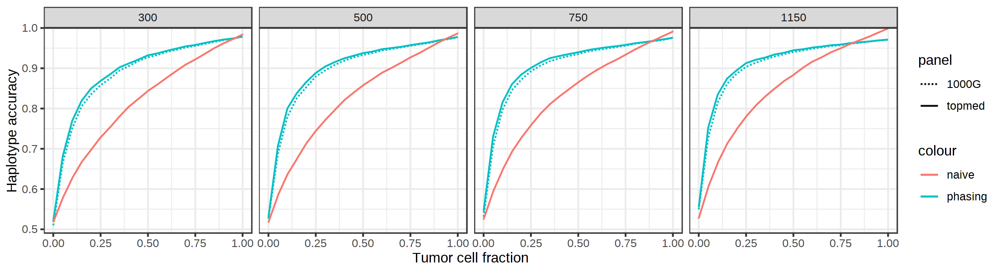

In [148]:
options(repr.plot.width = 11, repr.plot.height = 3, repr.plot.res = 200)

D %>%
group_by(ratio, panel, n_cells) %>%
summarise(
    naive_error = mean(haplo_naive != haplo_truth, na.rm = T),
    bw_error = mean(haplo_post != haplo_truth, na.rm = T),
    .groups = 'drop'
) %>%
ggplot() +
geom_line(aes(x = ratio, y = 1-bw_error, color = 'phasing', linetype = panel)) +
geom_line(aes(x = ratio, y = 1-naive_error, color = 'naive')) +
theme_bw() +
ylab('Haplotype accuracy') +
xlab('Tumor cell fraction') +
scale_linetype_manual(values = c('dashed', 'solid')) +
scale_y_continuous(expand = expansion(add = 0), limits = c(0.49, 1)) +
facet_wrap(~n_cells, nrow = 1)

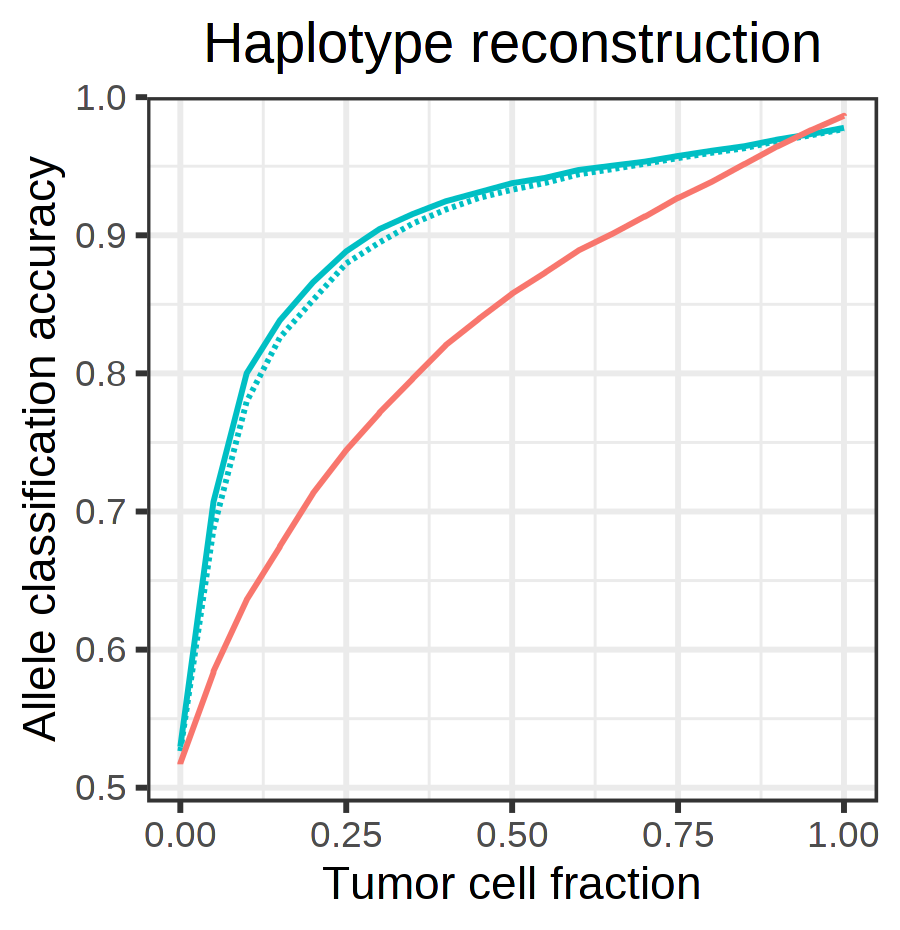

In [91]:
options(repr.plot.width = 3, repr.plot.height = 3.1, repr.plot.res = 300)

D %>%
filter(n_cells == 500) %>%
group_by(ratio, panel, n_cells) %>%
summarise(
    naive_error = mean(haplo_naive != haplo_truth, na.rm = T),
    bw_error = mean(haplo_post != haplo_truth, na.rm = T),
    .groups = 'drop'
) %>%
ggplot() +
geom_line(aes(x = ratio, y = 1-bw_error, color = 'phasing', linetype = panel)) +
geom_line(aes(x = ratio, y = 1-naive_error, color = 'naive')) +
theme_bw() +
ylab('Allele classification accuracy') +
xlab('Tumor cell fraction') +
scale_linetype_manual(values = c('dashed', 'solid')) +
scale_y_continuous(expand = expansion(add = 0), limits = c(0.49, 1)) +
theme(
    plot.title = element_text(hjust = 0.5),
    legend.position = 'none'
) +
ggtitle('Haplotype reconstruction')

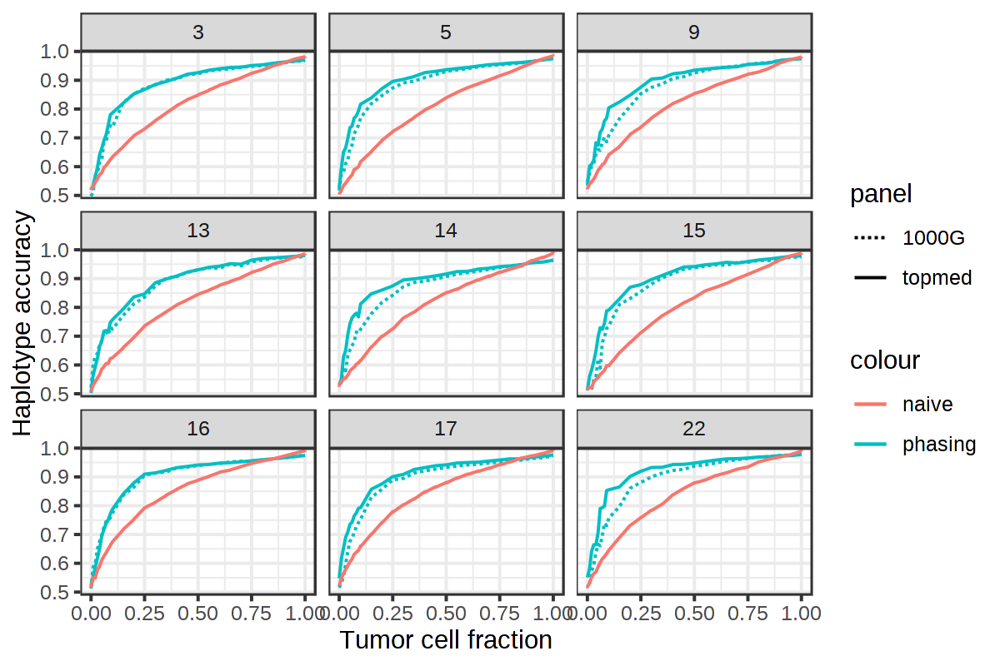

In [1140]:
options(repr.plot.width = 6, repr.plot.height = 4, repr.plot.res = 200)

D %>%
group_by(ratio, CHROM, panel) %>%
summarise(
    naive_error = mean(haplo_naive != haplo_truth, na.rm = T),
    hmm_error = mean(haplo_post != haplo_truth, na.rm = T),
    .groups = 'drop'
) %>%
ggplot() +
geom_line(aes(x = ratio, y = 1-hmm_error, color = 'phasing', linetype = panel)) +
geom_line(aes(x = ratio, y = 1-naive_error, color = 'naive')) +
theme_bw() +
facet_wrap(~CHROM) +
ylab('Haplotype accuracy') +
xlab('Tumor cell fraction') +
scale_linetype_manual(values = c('dashed', 'solid')) +
scale_y_continuous(expand = expansion(add = 0), limits = c(0.49, 1))

## Illustration

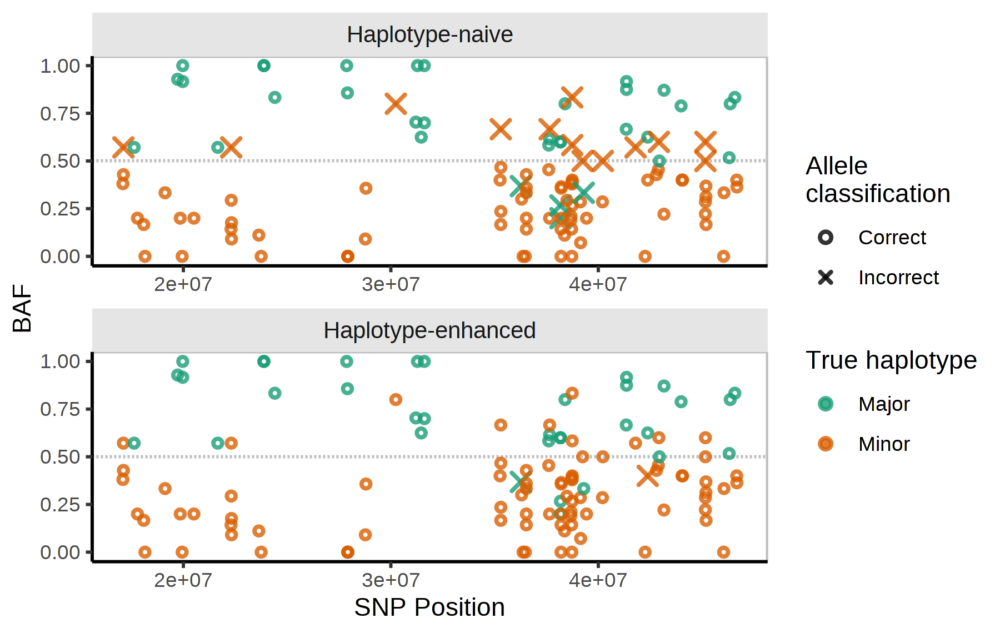

In [95]:
options(repr.plot.width = 6, repr.plot.height = 3.8, repr.plot.res = 300)

pal2 = RColorBrewer::brewer.pal(n = 8, 'Dark2')

D_haplo = bulks_all[['topmed']][['0.2_1_500']] %>%
    annot_consensus(segs_consensus) %>%
    filter(cnv_state == 'loh_2') %>%
    filter(CHROM == 22 & snp_index < 21840) %>%
    filter(DP >= 5) %>%
    mutate(snp_index = 1:n()) %>%
    left_join(haplo_truth, by = c('snp_id', 'CHROM')) %>%
    filter(!is.na(haplo_truth)) %>%
    mutate(phasing = haplo_post == haplo_truth) %>%
    mutate(naive = haplo_naive == haplo_truth) %>%
    reshape2::melt(measure.vars = c('phasing', 'naive'), variable.name = 'method') %>%
    mutate(method = factor(method, c('naive', 'phasing'))) %>%
    mutate(value = ifelse(value, 'Correct', 'Incorrect')) %>%
    mutate(haplo_truth = ifelse(haplo_truth == 'major', 'Major', 'Minor')) %>%
    mutate(CHROM = paste0('chr', CHROM)) %>%
    mutate(var_y = ifelse(method == 'naive', AR, 1-pBAF))

ggplot(
    D_haplo %>% 
        mutate(method = c('naive' = 'Haplotype-naive', 'phasing' = 'Haplotype-enhanced')[method]) %>%
        mutate(method = factor(method, unique(rev(method)))),
    aes(x = POS, y = AR, pch = value, color = haplo_truth, size = value),
    na.rm=TRUE
) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray') +
geom_point(
    alpha = 0.8,
    stroke = 1
) +
theme_classic() +
theme(
    panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
    strip.background = element_rect(fill = 'gray90', size = 0),
    strip.text = element_text(size = 10),
    legend.position = 'right'
) +
facet_wrap(~method, scale = 'free', ncol = 1) +
scale_shape_manual(values = c(1,4)) +
scale_size_manual(values = c(1,3)) +
scale_color_manual(values = c(pal2[1], pal2[2])) +
guides(
    color = guide_legend(title = 'True haplotype'),
    shape = guide_legend(title = 'Allele\nclassification'),
    size = 'none'
) +
ylab('BAF') +
xlab('SNP Position')

# Single-cell CNV evaluation

## Simulation

In [975]:
set.seed(0)

nodes = list()
cells_train = cell_annot[['TNBC4']] %>% filter(!cell %in% cells_exclude) %>% sample_frac(0.7) %>% pull(cell)
cells_test = cell_annot[['TNBC4']] %>% filter(!cell %in% cells_exclude) %>% filter(!cell %in% cells_train) %>% pull(cell)

n_cells = 750
ratios = c(seq(0, 0.1, 0.01), seq(0.15, 0.5, 0.05))

for (n in n_cells) {
    for (r in ratios) {
        for (s in 1:5) {

            set.seed(s)

            cells_tumor = cell_annot[['TNBC4']] %>% 
                filter(annot == 'T' & cell %in% cells_train) %>%
                pull(cell) %>% sample(n * r)

            cells_normal = cell_annot[['TNBC4']] %>%
                filter(annot == 'N' & cell %in% cells_train) %>% 
                pull(cell) %>% sample(n * (1-r))

            nodes[[paste0(r, '_', s, '_', n)]] = list(cells = c(cells_tumor, cells_normal), members = s, label = r, size = n)
        }
    }
}

In [417]:
R.utils::sourceDirectory('~/Numbat/R')

panels = c('topmed', '1000G')
bulks_all = list()
chroms = c(3, 5, 9, 13:17, 22)
lambda = 1

for (panel in panels) {
    display(panel)
    bulks_all[[panel]] = mclapply(
        nodes,
        mc.cores = 45,
        function(g) {

            bulk = get_allele_bulk(
                df = df[[panel]] %>% filter(cell %in% g$cells),
                genetic_map = genetic_map_hg38,
                min_depth = 0,
                lambda = lambda
            ) %>%
            mutate(
                n_cells = g$size,
                seed = g$members,
                ratio = g$label
            ) %>%
            annot_consensus(segs_consensus) %>%
            filter(CHROM %in% chroms & cnv_state == 'loh_2') %>%
            group_by(CHROM, seg) %>%
            mutate(
                approx_lik_ar(pAD, DP, p_s, gamma = 20, start = 0.1)
            ) %>%
            classify_alleles() %>%
            ungroup() %>%
            mutate(panel = panel, lambda = lambda)

    })    
}

[1] "topmed"

[1] "1000G"

In [418]:
R.utils::sourceDirectory('~/Numbat/R')

cell_res = list()

for (panel in panels) {
    display(panel)
    cell_res[[panel]] = mclapply(
        bulks_all[[panel]],
        mc.cores = 45,
        function(bulk) {
            
            bulk = bulk %>%
                annot_consensus(segs_consensus) %>%
                filter(CHROM %in% chroms)

            allele_post_naive = get_allele_post(
                bulk,
                segs_consensus %>% mutate(seg = seg_cons),
                df[[panel]] %>% filter(cell %in% cells_test),
                naive = TRUE
            )

            allele_post_phasing = get_allele_post(
                bulk,
                segs_consensus %>% mutate(seg = seg_cons),
                df[[panel]] %>% filter(cell %in% cells_test),
                naive = FALSE
            )

            allele_post = rbind(
                allele_post_naive %>% mutate(method = 'naive'),
                allele_post_phasing %>% mutate(method = 'phasing')
            ) %>%
            mutate(
                seed = unique(bulk$seed),
                ratio = unique(bulk$ratio)
            ) %>%
            mutate(panel = panel)

            return(allele_post)

    })
}

[1] "topmed"

[1] "1000G"

### Amplifications

In [1019]:
R.utils::sourceDirectory('~/Numbat/R')

panels = c('topmed', '1000G')
bulks_all = list()
lambda = 1

for (panel in 'topmed') {
    display(panel)
    bulks_all[[panel]] = mclapply(
        nodes,
        mc.cores = 30,
        function(g) {
            
            bulk = get_allele_bulk(
                df = df[[panel]] %>% filter(cell %in% g$cells),
                genetic_map = genetic_map_hg38,
                min_depth = 0,
                lambda = lambda
            ) %>%
            mutate(
                n_cells = g$size,
                seed = g$members,
                ratio = g$label
            ) %>%
            annot_consensus(
                segs_consensus_amp %>% mutate(cnv_state_post = cnv_state)
            ) %>%
            group_by(CHROM, seg) %>%
            mutate(
                approx_theta_post(pAD, DP, p_s, gamma = 20, start = 0.1)
            ) %>%
            classify_alleles() %>%
            ungroup() %>%
            mutate(panel = panel, lambda = lambda)
            
            return(bulk)

    })    
}

[1] "topmed"

In [1045]:
R.utils::sourceDirectory('~/Numbat/R')

cell_res_amp = list()

for (panel in c('topmed')) {
    display(panel)
    cell_res_amp[[panel]] = mclapply(
        bulks_all[[panel]],
        mc.cores = 30,
        function(bulk) {
                        
            allele_post_naive = get_allele_post(
                bulk,
                segs_consensus_amp %>% 
                    mutate(seg = factor(seg_cons)),
                df[[panel]] %>% filter(cell %in% cells_test),
                naive = TRUE
            )

            allele_post_phasing = get_allele_post(
                bulk,
                segs_consensus_amp %>%
                    mutate(seg = factor(seg_cons)),
                df[[panel]] %>% filter(cell %in% cells_test),
                naive = FALSE
            )

            allele_post = rbind(
                allele_post_naive %>% mutate(method = 'naive'),
                allele_post_phasing %>% mutate(method = 'phasing')
            ) %>%
            mutate(
                seed = unique(bulk$seed),
                ratio = unique(bulk$ratio)
            ) %>%
            mutate(panel = panel)

            return(allele_post)

    })
}

[1] "topmed"

## Results

In [97]:
cell_res = readRDS('~/paper_data/phasing_benchmark/cell_cnv_scores.rds')

In [98]:
D_sc = bind_rows(
        bind_rows(cell_res[['topmed']]) %>% mutate(panel = 'topmed'),
        bind_rows(cell_res[['1000G']]) %>% mutate(panel = '1000G')
    ) %>%
    inner_join(cell_annot[['TNBC4']], by = 'cell') %>%
    filter(total >= 3) %>%
    mutate(
        y = as.integer(annot == 'T'),
        y_hat = as.integer(p_cnv > 0.9)
    ) %>%
    group_by(ratio, method, panel) %>%
    summarise(
        precision = mean(y[y_hat == 1]),
        recall = mean(y_hat[y == 1]),
        auc = as.numeric(pROC::auc(y, logBF, direction = '<', levels = levels(as.factor(y)))),
        .groups = 'drop'
    )

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Warning message:
“Removed 12 row(s) containing missing values (geom_path).”
Warning message:
“Removed 12 row(s) containing missing values (geom_path).”


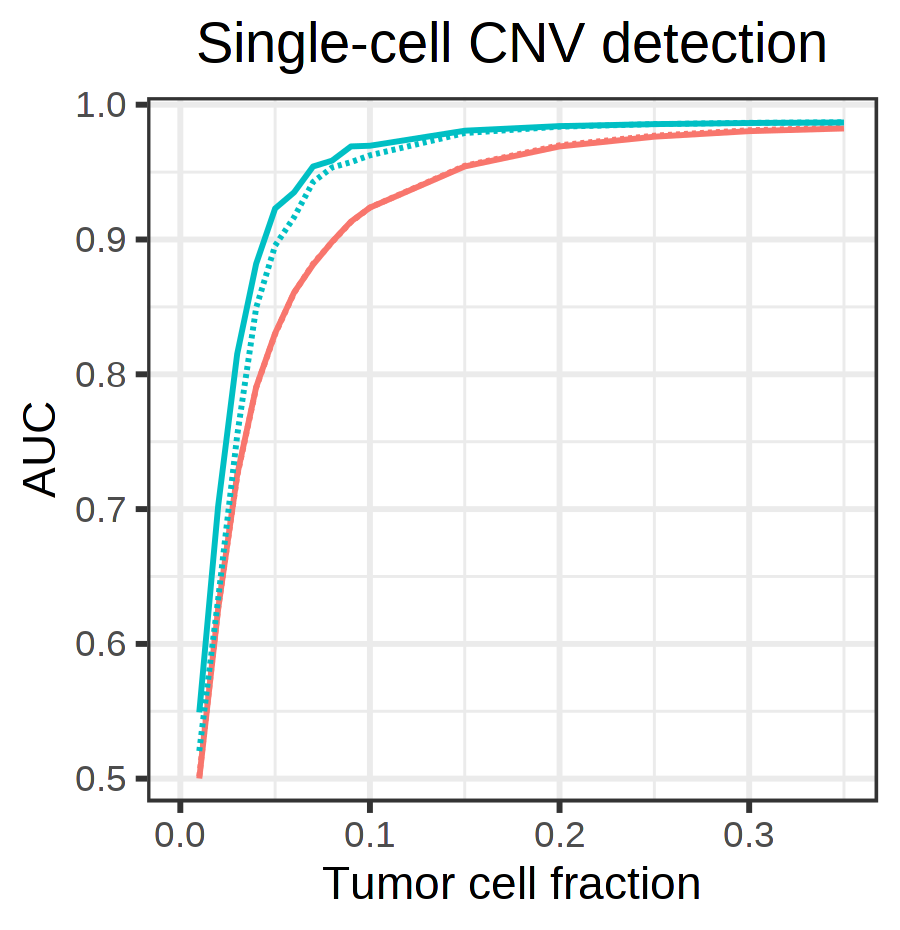

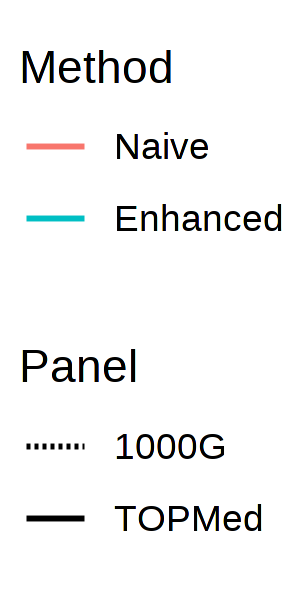

In [99]:
options(repr.plot.width = 3, repr.plot.height = 3.1, repr.plot.res = 300)

p = D_sc %>%
    filter(ratio > 0) %>%
    mutate(method_label = c('naive' = 'Naive', 'phasing' = 'Enhanced')[method]) %>%
    mutate(method_label = factor(method_label, unique(method_label))) %>%
    mutate(panel = ifelse(panel == 'topmed', 'TOPMed', '1000G')) %>%
    ggplot(
        aes(x = ratio, y = auc, color = method_label, linetype = panel)
    ) +
    theme_bw() +
    scale_linetype_manual(values = c('dashed', 'solid')) +
    geom_line() +
    xlim(0, 0.35) +
    xlab('Tumor cell fraction') +
    ylab('AUC') +
    theme(
        plot.title = element_text(hjust = 0.5)
    ) +
    ggtitle('Single-cell CNV detection') +
    ylim(0.5, 1) +
    scale_y_continuous(expand = expansion(mult = 0.035)) +
    guides(
        color = guide_legend(title = 'Method'),
        linetype = guide_legend(title = 'Panel')
    )

p + theme(legend.position = 'none')

options(repr.plot.width = 1, repr.plot.height = 2, repr.plot.res = 300)

as_ggplot(get_legend(p))

In [1047]:
D_sc = bind_rows(
        bind_rows(cell_res_amp[['topmed']]) %>% mutate(panel = 'topmed'),
    ) %>%
    inner_join(cell_annot[['TNBC4']], by = 'cell') %>%
    filter(total >= 3) %>%
    mutate(
        y = as.integer(annot == 'T'),
        y_hat = as.integer(p_cnv > 0.9)
    ) %>%
    group_by(ratio, method, panel) %>%
    summarise(
        precision = mean(y[y_hat == 1]),
        recall = mean(y_hat[y == 1]),
        auc = as.numeric(pROC::auc(y, logBF, direction = '<', levels = levels(as.factor(y)))),
        .groups = 'drop'
    )

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Warning message:
“Removed 6 row(s) containing missing values (geom_path).”


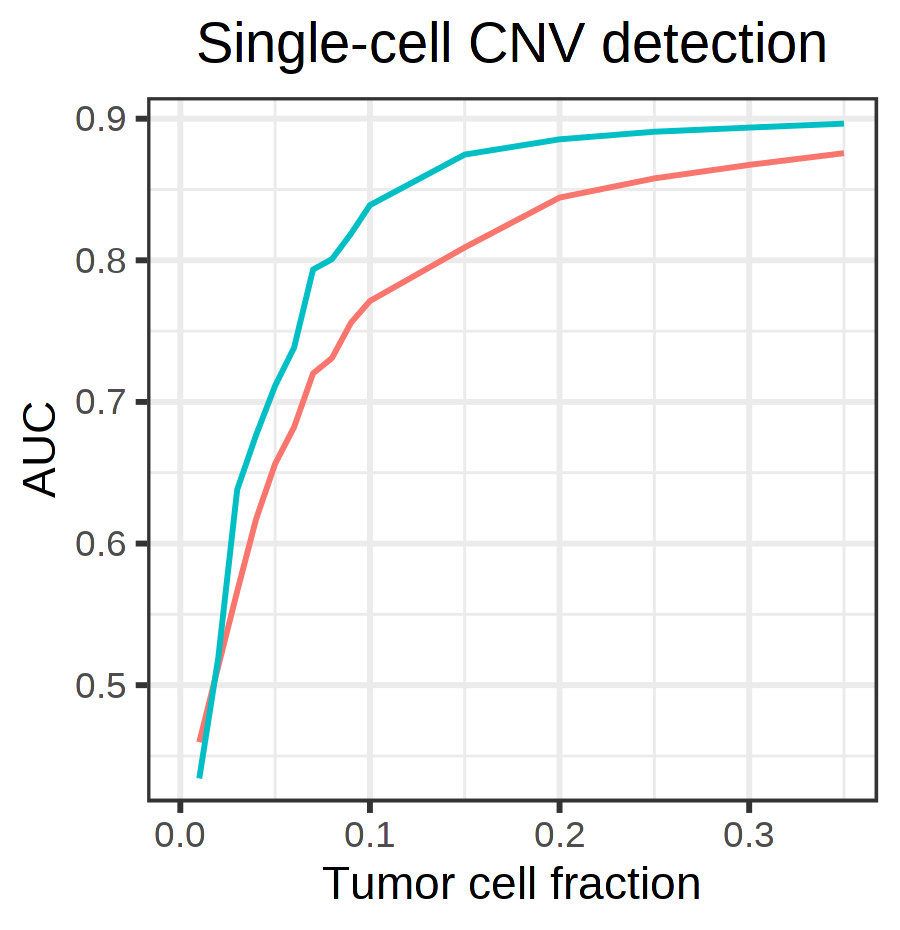

In [1063]:
options(repr.plot.width = 3, repr.plot.height = 3.1, repr.plot.res = 300)

D_sc %>%
    filter(ratio > 0) %>%
    ggplot(
        aes(x = ratio, y = auc, color = method)
    ) +
    theme_bw() +
    geom_line() +
    xlim(0, 0.35) +
    xlab('Tumor cell fraction') +
    ylab('AUC') +
    theme(
        plot.title = element_text(hjust = 0.5)
    ) +
    ggtitle('Single-cell CNV detection') +
    ylim(0.5, 1) +
    scale_y_continuous(expand = expansion(mult = 0.035)) +
    guides(
        color = guide_legend(title = 'Method'),
    ) +
    theme(legend.position = 'none')

## Illustration

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.



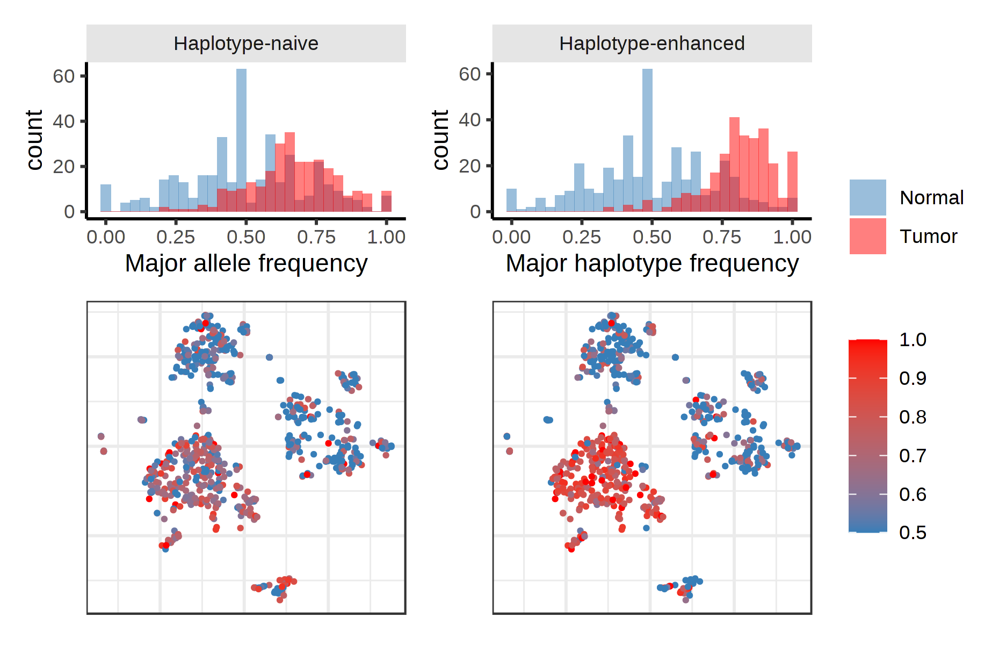

In [181]:
options(repr.plot.width = 6.2, repr.plot.height = 4, repr.plot.res = 300)

D = cell_res[['topmed']][['0.03_1_750']] %>% 
    left_join(cell_annot[['TNBC4']], by = 'cell') %>%
    filter(seg == '14_1') %>%
    filter(total >= 4) %>%
    mutate(annot = c('T' = 'Tumor', 'N' = 'Normal')[annot]) %>%
    mutate(method_label = c('naive' = 'Haplotype-naive', 'phasing' = 'Haplotype-enhanced')[method]) %>%
    mutate(method_label = factor(method_label, unique(rev(method_label))))

density_naive = D %>% 
    filter(method == 'naive') %>%
    ggplot(
        aes(x = MAF, fill = annot)
    ) +
    geom_histogram(alpha = 0.5, position = position_identity()) +
    theme_classic() +
    facet_wrap(~method_label) +
    guides(fill = 'none') +
    scale_fill_manual(values = c(pal[2], 'red')) +
    xlab('Major allele frequency') +
    theme(
        strip.background = element_rect(fill = 'gray90', size = 0)
    )

density_phasing = D %>% 
    filter(method == 'phasing') %>%
    ggplot(
        aes(x = MAF, fill = annot)
    ) +
    geom_histogram(alpha = 0.5, position = position_identity()) +
    theme_classic() +
    facet_wrap(~method_label) +
    guides(fill = guide_legend(title = '')) +
    scale_fill_manual(values = c(pal[2], 'red')) +
    xlab('Major haplotype frequency') +
    theme(
        strip.background = element_rect(fill = 'gray90', size = 0)
    )

cells_naive = con_TNBC$samples[['TNBC4']]$plotEmbedding(
    size = 0.5,
    alpha = 1,
    colors = D %>% filter(method == 'naive') %>%
        {setNames(.$MAF, .$cell)},
    plot.na = F,
    show.legend = F,
    plot.theme = theme_bw()
) +
scale_color_gradient(low = pal[2], high =  'red', limits = c(0.5, 1), oob = scales::oob_squish) +
guides(color = guide_colorbar(title = 'MAF', barwidth = 0.5, barheight = 4))

cells_phasing = con_TNBC$samples[['TNBC4']]$plotEmbedding(
    size = 0.5,
    alpha = 1,
    colors = D %>% filter(method == 'phasing') %>%
        {setNames(.$MAF, .$cell)},
    plot.na = F,
    show.legend = T,
    plot.theme = theme_bw()
) +
scale_color_gradient(low = pal[2], high =  'red', limits = c(0.5, 1), oob = scales::oob_squish) +
guides(color = guide_colorbar(title = ''))

(
    (density_naive / cells_naive) + plot_layout(heights = c(1,2)) | 
    (density_phasing / cells_phasing) + plot_layout(heights = c(1,2))
) +
plot_layout(guides = 'collect')